In [39]:
def yolo_to_pascal_voc(x_center, y_center, w, h, image_w, image_h):
    """ Converts YOLO format (normalized) to Pascal VOC format (pixel coordinates) """
    x1 = int((x_center - (w / 2)) * image_w)
    y1 = int((y_center - (h / 2)) * image_h)
    x2 = int((x_center + (w / 2)) * image_w)
    y2 = int((y_center + (h / 2)) * image_h)
    return x1, y1, x2, y2

def coco_to_yolo(x1, y1, w, h, image_w, image_h):
    x_center = (x1 + (w / 2)) / image_w
    y_center = (y1 + (h / 2)) / image_h
    w = w / image_w
    h = h / image_h
    return x_center, y_center, w, h

def yolo_to_coco(x_center, y_center, w, h,  image_w, image_h):
    w = w * image_w
    h = h * image_h
    x1 = ((2 * x_center * image_w) - w)/2
    y1 = ((2 * y_center * image_h) - h)/2
    return x1, y1, w, h

In [40]:
import json
import cv2
import matplotlib.pyplot as plt
import numpy as np

def visualize_image_with_bboxes(json_file, class_names, img_path=None, image_index=None):
    # Load the JSON file containing metadata
    with open(json_file, 'r') as file:
        parsed_data = json.load(file)
    
    # Get the image data for the specified index or path
    if img_path is not None:
        # Find the image data by path
        image_data = next((item for item in parsed_data if item['image'] == img_path), None)
        if image_data is None:
            print(f"Image path {img_path} not found in JSON file.")
            return
        image_path = img_path
    elif image_index is not None:
        # Find the image data by index
        if image_index < 1 or image_index > len(parsed_data):
            print(f"Invalid image index: {image_index}. Please provide a value between 1 and {len(parsed_data)}.")
            return
        image_data = parsed_data[image_index - 1]
        image_path = image_data['image']
    else:
        print("Either img_path or image_index must be provided.")
        return
    
    annotations = image_data['annotations']
    
    # Read the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Could not read image {image_path}")
        return
    
    # Draw the bounding boxes on the image
    for ann in annotations:
        classname = ann['classname']
        if classname not in class_names:
            continue
        bbox = ann['bbox']
        
        # Convert bbox to pixel coordinates
        x_min = int(bbox[0])
        y_min = int(bbox[1])
        x_max = int(bbox[0] + bbox[2])
        y_max = int(bbox[1] + bbox[3])

        print('coco: ', bbox)
        print(coco_to_yolo(bbox[0], bbox[1], bbox[2], bbox[3], image.shape[1], image.shape[0]))

        color = np.random.uniform(0, 255, 3)
        # Draw the bounding box
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)
        label_y = y_min - 10 if y_min - 10 > 10 else y_min + 20
        # Put the class label
        cv2.putText(image, classname, (x_min, label_y), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    
    # Convert BGR image to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()


In [41]:
def read_classes():
    with open('classes.txt', 'r') as file:
        class_names = file.read().replace('-', '').split('\n')
        class_names = [x.strip() for x in class_names if x.strip()]
    return class_names

['chair', 'table', 'pillow', 'desk', 'sofa_chair', 'cabinet', 'lamp', 'sofa', 'door', 'bed', 'box', 'garbage_bin', 'monitor', 'shelf', 'counter', 'computer', 'endtable', 'sink', 'bookshelf', 'night_stand', 'drawer', 'dresser', 'paper', 'painting', 'keyboard', 'coffee_table', 'cpu', 'ottoman', 'tv', 'picture', 'stool', 'recycle_bin', 'whiteboard', 'bench', 'toilet', 'mirror', 'fridge', 'printer', 'curtain', 'bottle', 'laptop', 'vanity', 'towel', 'plant', 'books']
coco:  [148, 170, 225, 257]
(0.464349376114082, 0.6990632318501171, 0.40106951871657753, 0.6018735362997658)
coco:  [166.67012089810018, 189.53195164075993, 29.499136442141634, 44.986183074265995]
(0.3233862551143868, 0.496545768566494, 0.052583130912908435, 0.10535405872193442)
coco:  [491, 176, 70.22107081174443, 137.42832469775476]
(0.937808441008685, 0.5731010827842562, 0.12517124921879577, 0.3218461936715568)
coco:  [449.8618307426598, 156.34542314335062, 72.13816925734022, 100.29706390328153]
(0.8661870149221567, 0.483592

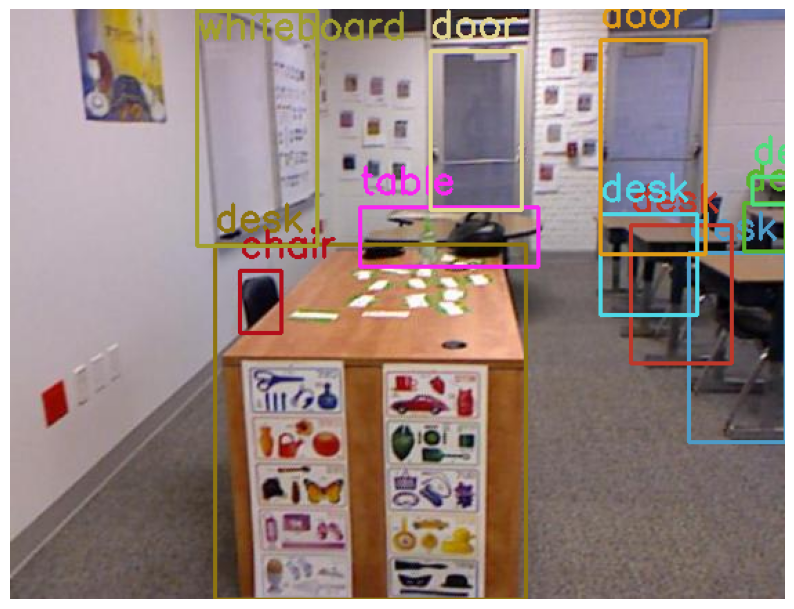

coco:  [328, 152, 346, 320]
(0.6863013698630137, 0.5886792452830188, 0.473972602739726, 0.6037735849056604)
coco:  [572.5418060200669, 275.6354515050167, 98.37792642140471, 53.17725752508363]
(0.8516859852476292, 0.5702341137123745, 0.13476428276904753, 0.10033444816053516)
coco:  [332.3578595317726, 318.17725752508363, 316.4046822742475, 209.16387959866222]
(0.672000274888899, 0.7976588628762542, 0.4334310716085582, 0.39464882943143814)
coco:  [1, 1, 221, 529]
(0.15273972602739727, 0.5009433962264151, 0.30273972602739724, 0.9981132075471698)
coco:  [614.1973244147157, 200.30100334448161, 54.94983277591973, 93.9464882943144]
(0.8790030695927062, 0.4665551839464883, 0.07527374352865716, 0.1772575250836121)
coco:  [414.4871794871795, 230.43478260869566, 153.26210826210826, 48.154960981047935]
(0.6727647035866213, 0.48021181716833894, 0.20994809350973734, 0.09085841694537346)


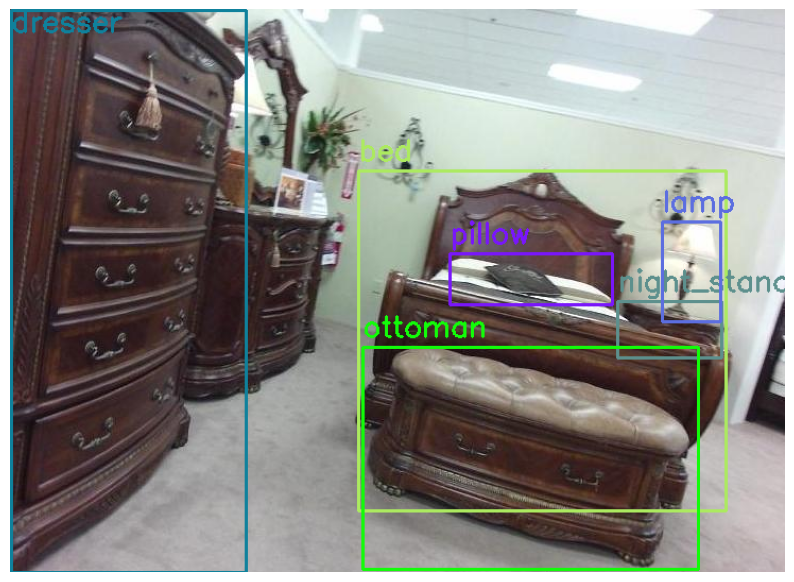

In [ ]:
json_file = 'info.json'

class_names = read_classes()
print(class_names)
visualize_image_with_bboxes(json_file, class_names, img_path='image/01983.jpg')

# Visualize by image index, filtering for specific classes
visualize_image_with_bboxes(json_file, class_names, image_index=1)

In [43]:
import os
import random
import cv2
import matplotlib.pyplot as plt

def visualize_image_with_bboxes_2(image_dir, label_dir, class_names, img_path=None):
    # Get a list of all image files in the directory
    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]
    
    if not image_files:
        print("No images found in the specified directory.")
        return None
    
    # Select a random image file if no image path is provided
    if img_path is None:
        image_file = random.choice(image_files)
        image_path = os.path.join(image_dir, image_file)
    else:
        image_file = os.path.basename(img_path)
        image_path = os.path.join(image_dir, image_file)
    
    # Read the image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Could not read image {image_path}")
        return None
    
    # Get the corresponding label file
    label_file = os.path.splitext(image_file)[0] + '.txt'
    label_path = os.path.join(label_dir, label_file)
    
    if not os.path.exists(label_path):
        print(f"Warning: Label file {label_path} not found.")
        return None
    
    # Read the label file
    with open(label_path, 'r') as file:
        labels = file.readlines()
    
    height, width, _ = image.shape
    
    # Draw the bounding boxes on the image
    for label in labels:
        parts = label.strip().split()
        class_id = int(parts[0])
        x_center = float(parts[1])
        y_center = float(parts[2])
        bbox_width = float(parts[3])
        bbox_height = float(parts[4])

        print((x_center, y_center, bbox_width, bbox_height))
        
        x_min, y_min, x_max, y_max = yolo_to_pascal_voc(x_center, y_center, bbox_width, bbox_height, width, height)
        classname = class_names[class_id]
        
        color = tuple(map(int, np.random.uniform(0, 255, 3)))
        # Draw the bounding box
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)
        label_y = y_min - 10 if y_min - 10 > 10 else y_min + 20
        # Put the class label
        cv2.putText(image, classname, (x_min, label_y), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    
    # Convert BGR image to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title(f"Image: {image_file}")
    plt.axis('off')
    plt.show()
    return image_file



In [44]:
# Example usage
image_dir = './content_processed/RGBD/train/images'  # Path to your images directory
label_dir = './content_processed/RGBD/train/labels'  # Path to your labels directory

(0.31049069373942473, 0.29591836734693877, 0.0829103214890017, 0.18820861678004536)
(0.308887235230021, 0.37061177001341544, 0.059398835942275456, 0.215146442521162)
(0.2618554052497763, 0.7761038097612517, 0.19033318273225788, 0.31864752881955566)
(0.23096446700507614, 0.9070294784580499, 0.23519458544839256, 0.18594104308390022)


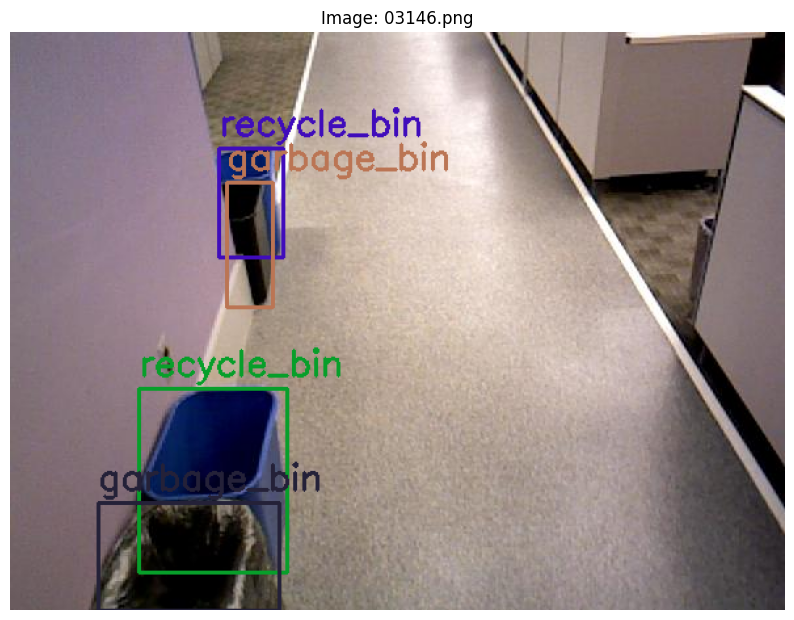

Image path image/03146.png not found in JSON file.


In [45]:
img_file = visualize_image_with_bboxes_2(image_dir, label_dir, class_names)
visualize_image_with_bboxes(json_file, class_names, img_path=f'image/{img_file}')

In [ ]:
import os
import cv2

def get_unique_image_shapes(image_dir):
    unique_shapes = set()  # Store unique (height, width, channels)

    for file in os.listdir(image_dir):
        if file.endswith(('.jpg', '.png', '.jpeg')):  # Filter image files
            image_path = os.path.join(image_dir, file)
            
            # Read the image
            image = cv2.imread(image_path)
            if image is None:
                print(f"Warning: Could not read {image_path}")
                continue
            
            height, width, channels = image.shape
            unique_shapes.add((height, width, channels))
    
    return unique_shapes

image_directory = "depth_bfx"

# Get and print unique image shapes
unique_shapes = get_unique_image_shapes(image_directory)
print("Unique image shapes found:")
for shape in unique_shapes:
    print(shape)


Unique image shapes found:
(531, 681, 3)
(427, 561, 3)
(530, 730, 3)
(441, 591, 3)


In [47]:
def count_class_instances(json_file, class_names):
    # Load the JSON file containing metadata
    with open(json_file, 'r') as file:
        parsed_data = json.load(file)
    
    # Initialize a dictionary to store the count of each class
    class_counts = {classname: 0 for classname in class_names}
    
    # Iterate through the annotations and count the instances of each class
    for image_data in parsed_data:
        annotations = image_data.get('annotations', [])
        for ann in annotations:
            classname = ann['classname']
            if classname in class_counts:
                class_counts[classname] += 1
    sorted_class_counts = sorted(class_counts.items(), key=lambda item: item[1], reverse=True)
    # Print out the results
    for classname, count in sorted_class_counts:
        print(f"{classname}: {count}")

In [48]:
count_class_instances(json_file, class_names)

chair: 24599
table: 6591
pillow: 4655
desk: 3617
sofa_chair: 2090
cabinet: 1848
lamp: 1752
sofa: 1720
door: 1580
bed: 1548
box: 1451
garbage_bin: 1302
monitor: 1299
shelf: 1299
counter: 926
computer: 848
endtable: 772
sink: 758
bookshelf: 712
night_stand: 688
drawer: 661
dresser: 584
paper: 501
painting: 450
keyboard: 438
coffee_table: 436
cpu: 415
ottoman: 396
tv: 395
picture: 391
stool: 378
recycle_bin: 376
whiteboard: 346
bench: 340
toilet: 340
mirror: 308
fridge: 285
printer: 270
curtain: 267
bottle: 253
laptop: 243
vanity: 238
towel: 228
plant: 210
books: 208


In [49]:
from collections import defaultdict
def count_all_class_instances(json_file):
    # Load the JSON file containing metadata
    with open(json_file, 'r') as file:
        parsed_data = json.load(file)
    
    # Initialize a dictionary to store the count of each class
    class_counts = defaultdict(int)
    
    # Iterate through the annotations and count the instances of each class
    for image_data in parsed_data:
        annotations = image_data.get('annotations', [])
        for ann in annotations:
            classname = ann['classname']
            class_counts[classname] += 1
    
    # Sort the class counts by value
    sorted_class_counts = sorted(class_counts.items(), key=lambda item: item[1], reverse=True)
    
    # Print out the results
    for classname, count in sorted_class_counts:
        print(f"{classname}: {count}")


In [ ]:
count_all_class_instances(json_file)

chair: 24599
table: 6591
pillow: 4655
desk: 3617
sofa_chair: 2090
cabinet: 1848
lamp: 1752
sofa: 1720
door: 1580
bed: 1548
box: 1451
garbage_bin: 1302
monitor: 1299
shelf: 1299
counter: 926
computer: 848
endtable: 772
sink: 758
bookshelf: 712
night_stand: 688
drawer: 661
dresser: 584
paper: 501
painting: 450
keyboard: 438
coffee_table: 436
cpu: 415
ottoman: 396
tv: 395
picture: 391
stool: 378
recycle_bin: 376
whiteboard: 346
bench: 340
toilet: 340
mirror: 308
fridge: 285
printer: 270
curtain: 267
bottle: 253
laptop: 243
vanity: 238
towel: 228
plant: 210
books: 208
book: 207
cloth: 201
microwave: 190
bag: 180
dresser_mirror: 172
cup: 170
stove: 165
mouse: 153
bowl: 153
back_pack: 152
bathtub: 150
cart: 140
tray: 139
person: 134
rack: 117
plate: 117
container: 117
telephone: 116
mug: 115
poster: 113
podium: 113
tissue: 111
blinds: 110
tv_stand: 105
speaker: 105
cubby: 104
scanner: 103
bulletin_board: 99
projector: 92
suits_case: 90
blackboard: 89
organizer: 87
island: 86
urinal: 84
pot: 

In [ ]:
def display_rgbd_image(image_path):
    """
    Displays the RGB, depth, and RGBD channels of an RGBD image.

    Args:
        image_path (str): Path to the RGBD image.
    """
    rgbd = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    if rgbd is None:
        print(f"Error: Could not read image at {image_path}")
        return

    print(f"Image shape: {rgbd.shape}")

    # Extract RGB part
    rgb = cv2.cvtColor(rgbd[:, :, :3], cv2.COLOR_BGR2RGB)

    # Extract depth channel
    if rgbd.shape[2] == 4:
        depth = rgbd[:, :, 3]
    else:
        print("Image does not have a depth channel!")
        return
    
     # Normalize the depth channel for visualization
    depth_normalized = cv2.normalize(depth, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Apply a color map to the depth channel
    depth_colormap = cv2.applyColorMap(depth_normalized, cv2.COLORMAP_TWILIGHT_SHIFTED)

    # Combine RGB and depth colormap into a single visualization
    combined = cv2.addWeighted(rgb, 0.9, depth_colormap, 0.1, 0)

    plt.imshow(rgb)
    plt.title("RGB Channels")
    plt.axis('off')
    plt.show()

    plt.imshow(depth, cmap='gray')
    plt.title("Depth Channel")
    plt.axis('off')
    plt.show()

    plt.imshow(combined) 
    plt.title("RGBD Visualization")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Image shape: (530, 730, 4)


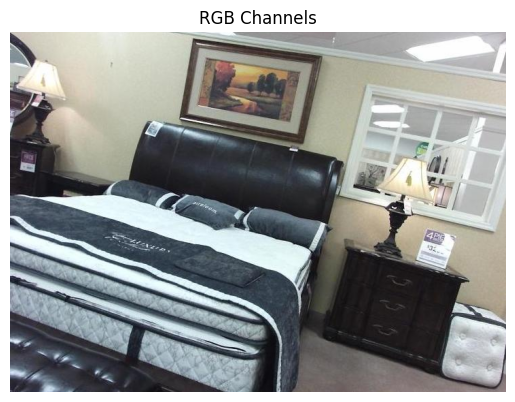

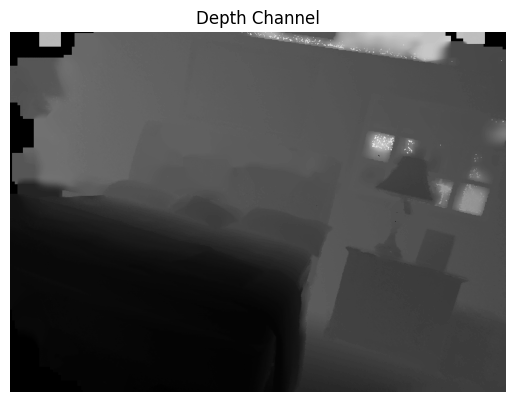

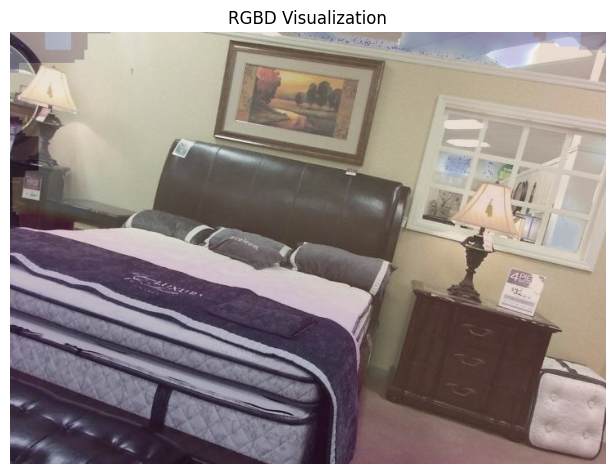

In [62]:
display_rgbd_image("content_processed/RGBD/train/images/00001.png")

In [1]:
import glob
import yaml
import tifffile as tiff
class RGBD_Dataset:
    def __init__(self, images_dir, labels_dir, yaml_path):
        # Load class names from YAML
        with open(yaml_path, 'r') as f:
            data = yaml.safe_load(f)
            self.class_names = data.get('names', {})
        
        # Get all image and label files
        self.image_files = sorted(glob.glob(os.path.join(images_dir, "*.tiff")))
        self.label_files = sorted(glob.glob(os.path.join(labels_dir, "*.txt")))
        
        # Match images with labels (by filename without extension)
        self.matched_pairs = []
        image_basenames = {os.path.splitext(os.path.basename(f))[0]: f for f in self.image_files}
        label_basenames = {os.path.splitext(os.path.basename(f))[0]: f for f in self.label_files}
        
        # Find common keys
        common_keys = set(image_basenames.keys()) & set(label_basenames.keys())
        self.matched_pairs = [(image_basenames[k], label_basenames[k]) for k in common_keys]
        
        print(f"Found {len(self.image_files)} images, {len(self.label_files)} labels")
        print(f"Successfully matched {len(self.matched_pairs)} image-label pairs")
    
    def __len__(self):
        return len(self.matched_pairs)
    
    def __getitem__(self, idx):
        img_path, label_path = self.matched_pairs[idx]
        
        # Load TIFF image
        image = tiff.imread(img_path)
        
        # Parse YOLO format labels
        with open(label_path, 'r') as f:
            labels = f.readlines()
        
        boxes = []
        classes = []
        for label in labels:
            parts = label.strip().split()
            if len(parts) == 5:
                class_id = int(parts[0])
                x_center, y_center, width, height = map(float, parts[1:5])
                
                # Convert to xyxy format
                img_height, img_width = image.shape[0], image.shape[1]
                x1 = (x_center - width/2) * img_width
                y1 = (y_center - height/2) * img_height
                x2 = (x_center + width/2) * img_width
                y2 = (y_center + height/2) * img_height
                
                boxes.append([x1, y1, x2, y2])
                classes.append(class_id)
        
        
        return img_path, image, {"boxes": boxes, "classes": classes}

In [2]:
import tifffile as tiff
from ultralytics import YOLO
import os
rgb_model = YOLO('./models/RGB/weights/best.pt')
depth_model = YOLO('./models/Depth/weights/best.pt')
rgbd_model = YOLO('./models/RGBD/weights/best.pt')

In [3]:
import supervision as sv
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from supervision.metrics import MeanAveragePrecision

import supervision as sv
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from supervision.metrics import MeanAveragePrecision

def evaluate_models_on_dataset(dataset, models, model_names, iou_threshold=0.5, conf_threshold=0.25):
    """
    Evaluate multiple models on a dataset and compare their performance.
    
    Args:
        dataset: RGBD_Dataset instance
        models: List of YOLO models
        model_names: List of names for each model
        iou_threshold: IoU threshold for considering a detection correct
        conf_threshold: Confidence threshold for predictions
        
    Returns:
        DataFrame with per-image comparison results and overall metrics
    """
    results = []
    
    # For overall mAP calculation
    all_predictions = {name: [] for name in model_names}
    all_targets = {name: [] for name in model_names}
    
    for idx in tqdm(range(len(dataset)), desc="Evaluating models"):
        img_path, image, target = dataset[idx]
        
        # Extract ground truth
        gt_boxes = np.array(target['boxes'])
        gt_classes = np.array(target['classes'])
        
        # Skip samples with no annotations
        if len(gt_boxes) == 0:
            continue
        
        gt_confidence = np.ones(len(gt_classes))
        gt_detections = sv.Detections(
            xyxy=gt_boxes,
            class_id=gt_classes,
            confidence=gt_confidence
        )
        
        image_results = {
            'image_path': img_path,
            'gt_boxes_count': len(gt_boxes)
        }
        
        # Process each model
        for i, (model, name) in enumerate(zip(models, model_names)):
            # Select appropriate input based on model type
            if name == "RGB":
                # RGB image for RGB model (first 3 channels)
                input_image = image[:,:,:3] if image.shape[2] == 4 else image
                
            elif name == "Depth":
                # Depth image for Depth model (take the depth channel and convert to 3-channel)
                if image.shape[2] == 4:
                    # Extract depth channel (last channel)
                    depth_channel = image[:,:,3]
                    # Convert to 3-channel (repeat the depth channel)
                    input_image = np.stack((depth_channel, depth_channel, depth_channel), axis=2)
                else:
                    input_image = image  # Fallback if not RGBD
                    
            else:  # RGBD
                input_image = image
                
            # Get predictions
            try:
                results_model = model(input_image, conf=conf_threshold, verbose=False)[0]
                detections = sv.Detections.from_ultralytics(results_model)
                
                # Store for mAP calculation
                all_predictions[name].append(detections)
                all_targets[name].append(gt_detections)
                
                # Calculate metrics for this image
                tp, fp, fn = calculate_image_metrics(detections, gt_detections, iou_threshold)
                
                image_results[f'{name}_detected'] = len(detections)
                image_results[f'{name}_tp'] = tp
                image_results[f'{name}_fp'] = fp
                image_results[f'{name}_fn'] = fn
                image_results[f'{name}_precision'] = tp / (tp + fp) if (tp + fp) > 0 else 0
                image_results[f'{name}_recall'] = tp / (tp + fn) if (tp + fn) > 0 else 0
            except Exception as e:
                print(f"Error processing image {img_path} with model {name}: {e}")
                image_results[f'{name}_detected'] = 0
                image_results[f'{name}_tp'] = 0
                image_results[f'{name}_fp'] = 0
                image_results[f'{name}_fn'] = len(gt_boxes)
                image_results[f'{name}_precision'] = 0
                image_results[f'{name}_recall'] = 0
            
        results.append(image_results)
    
    # Calculate overall metrics
    map_scores = {}
    for name in model_names:
        if all_predictions[name] and all_targets[name]:
            map_metric = MeanAveragePrecision()
            map_result = map_metric.update(all_predictions[name], all_targets[name]).compute()
            map_scores[name] = {
                'mAP_50_95': map_result.map50_95,
                'mAP_50': map_result.map50,
                'mAP_75': map_result.map75,
                'ap_per_class': map_result.ap_per_class
            }
    
    return pd.DataFrame(results), map_scores

def calculate_image_metrics(detections, gt_detections, iou_threshold=0.5):
    """Calculate TP, FP, FN for a single image"""
    # Match detections to ground truth
    matches = []
    used_gt = set()
    
    # For each prediction, find best matching ground truth
    for i, pred_box in enumerate(detections.xyxy):
        pred_class = detections.class_id[i]
        best_iou = iou_threshold
        best_gt_idx = -1
        
        for j, gt_box in enumerate(gt_detections.xyxy):
            if j in used_gt:
                continue
                
            gt_class = gt_detections.class_id[j]
            
            # Only match same class
            if pred_class == gt_class:
                iou = calculate_iou(pred_box, gt_box)
                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = j
        
        if best_gt_idx >= 0:
            matches.append((i, best_gt_idx))
            used_gt.add(best_gt_idx)
    
    tp = len(matches)
    fp = len(detections) - tp
    fn = len(gt_detections) - tp
    
    return tp, fp, fn

def calculate_iou(box1, box2):
    """Calculate IoU between two boxes in xyxy format"""
    x1_min, y1_min, x1_max, y1_max = box1
    x2_min, y2_min, x2_max, y2_max = box2
    
    # Calculate intersection
    x_min = max(x1_min, x2_min)
    y_min = max(y1_min, y2_min)
    x_max = min(x1_max, x2_max)
    y_max = min(y1_max, y2_max)
    
    if x_max < x_min or y_max < y_min:
        return 0.0
        
    intersection = (x_max - x_min) * (y_max - y_min)
    
    # Calculate union
    area1 = (x1_max - x1_min) * (y1_max - y1_min)
    area2 = (x2_max - x2_min) * (y2_max - y2_min)
    union = area1 + area2 - intersection
    
    return intersection / union if union > 0 else 0.0

In [4]:
# Prepare the models and dataset
models = [rgb_model, depth_model, rgbd_model]
model_names = ["RGB", "Depth", "RGBD"]

# Use the validation dataset
dataset = RGBD_Dataset(
    images_dir="./content_processed/RGBD/val/images",
    labels_dir="./content_processed/RGBD/val/labels",
    yaml_path="./data_rgbd.yaml"
)

# Run evaluation
results_df, map_scores = evaluate_models_on_dataset(dataset, models, model_names)

print("\n=== Mean Average Precision ===")
metrics_df = pd.DataFrame({
    name: {
        'mAP@0.5': map_scores[name]['mAP_50'],
        'mAP@0.75': map_scores[name]['mAP_75'],
        'mAP@0.5:0.95': map_scores[name]['mAP_50_95']
    } for name in model_names
})
print(metrics_df.transpose())

Found 2054 images, 2054 labels
Successfully matched 2054 image-label pairs


Evaluating models:   0%|          | 0/2054 [00:00<?, ?it/s]

Evaluating models: 100%|██████████| 2054/2054 [07:38<00:00,  4.48it/s]



=== Mean Average Precision ===
        mAP@0.5  mAP@0.75  mAP@0.5:0.95
RGB    0.405922  0.343504      0.307026
Depth  0.371320  0.296644      0.268382
RGBD   0.454839  0.388342      0.347137


In [5]:
def find_interesting_examples(results_df, model_names, difference_threshold=0.3):
    """
    Find images where RGB and RGBD models disagree significantly in their performance.
    Also calculate F1 score for Depth model, but do not use it for filtering.

    Args:
        results_df: DataFrame with model comparison results
        model_names: List of model names (expects ["RGB", "Depth", "RGBD"])
        difference_threshold: Threshold for considering a difference significant

    Returns:
        List of dictionaries containing interesting examples
    """
    interesting = []
    added_images = set()

    for _, row in results_df.iterrows():
        image_path = row['image_path']
        if image_path in added_images:
            continue

        # Calculate F1 scores for all models
        f1_scores = {}
        for name in model_names:
            tp = row.get(f'{name}_tp', 0)
            fp = row.get(f'{name}_fp', 0)
            fn = row.get(f'{name}_fn', 0)
            precision = tp / (tp + fp) if (tp + fp) > 0 else 0
            recall = tp / (tp + fn) if (tp + fn) > 0 else 0
            f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
            f1_scores[name] = f1

        # Only use RGB and RGBD for filtering
        if abs(f1_scores["RGB"] - f1_scores["RGBD"]) > difference_threshold:
            interesting.append({
                'image_path': image_path,
                'difference': abs(f1_scores["RGB"] - f1_scores["RGBD"]),
                'better_model': "RGB" if f1_scores["RGB"] > f1_scores["RGBD"] else "RGBD",
                'worse_model': "RGBD" if f1_scores["RGB"] > f1_scores["RGBD"] else "RGB",
                'f1_scores': f1_scores  # includes Depth
            })
            added_images.add(image_path)
    return interesting

In [6]:
def visualize_model_comparison(img_path, models, model_names, dataset):
    """
    Visualize detection results from different models on the same image.
    
    Args:
        img_path: Path to the image
        models: List of YOLO models
        model_names: List of model names
        dataset: RGBD_Dataset instance for class names
    """
    # Load image
    image = tiff.imread(img_path)
    
    # Extract base filename to find corresponding label
    base_filename = os.path.splitext(os.path.basename(img_path))[0]
    label_path = os.path.join(os.path.dirname(os.path.dirname(img_path)), 'labels', f"{base_filename}.txt")
    
    # Get ground truth
    gt_boxes = []
    gt_classes = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) == 5:
                    class_id = int(parts[0])
                    x_center, y_center, width, height = map(float, parts[1:5])
                    
                    # Convert to xyxy format
                    img_height, img_width = image.shape[0], image.shape[1]
                    x1 = (x_center - width/2) * img_width
                    y1 = (y_center - height/2) * img_height
                    x2 = (x_center + width/2) * img_width
                    y2 = (y_center + height/2) * img_height
                    
                    gt_boxes.append([x1, y1, x2, y2])
                    gt_classes.append(class_id)
    
    # Create ground truth detection
    gt_confidence = np.ones(len(gt_classes))
    gt_detections = sv.Detections(
        xyxy=np.array(gt_boxes),
        class_id=np.array(gt_classes),
        confidence=gt_confidence
    )
    
    # Display image and model predictions
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # Prepare display image (use only RGB channels)
    display_image = image[:,:,:3].copy() if image.shape[2] == 4 else image.copy()
    
    # Ground truth
    box_annotator = sv.BoxAnnotator(color=sv.Color.BLUE)
    label_annotator = sv.LabelAnnotator(text_position=sv.Position.CENTER, color=sv.Color.BLUE)
    
    gt_image = display_image.copy()
    gt_labels = [f"{dataset.class_names[int(class_id)]}" for class_id in gt_classes]
    gt_image = box_annotator.annotate(scene=gt_image, detections=gt_detections)
    gt_image = label_annotator.annotate(
        scene=gt_image, 
        detections=gt_detections, 
        labels=gt_labels
    )
    
    axes[0, 0].imshow(gt_image)
    axes[0, 0].set_title('Ground Truth', fontsize=14)
    axes[0, 0].axis('off')
    
    # Process each model
    for i, (model, name) in enumerate(zip(models, model_names)):
        row, col = (i+1) // 2, (i+1) % 2
        ax = axes[row, col]
        
        if name == "RGB":
            input_image = image[:,:,:3] if image.shape[2] == 4 else image
            
        elif name == "Depth":
            if image.shape[2] == 4:
                depth_channel = image[:,:,3]
                input_image = np.stack((depth_channel, depth_channel, depth_channel), axis=2)
            else:
                input_image = image
                
        else:  # RGBD
            input_image = image
        
        try:
            if name == "Depth":
                results_model = model(input_image, verbose=False)[0]
            else:
                results_model = model(input_image, verbose=False)[0]
                
            detections = sv.Detections.from_ultralytics(results_model)
            
            # Create annotated image
            model_image = display_image.copy()  # Always use RGB for display
            model_color = sv.Color.RED
            box_annotator = sv.BoxAnnotator(color=model_color)
            label_annotator = sv.LabelAnnotator(text_position=sv.Position.CENTER, color=model_color)
            model_image = box_annotator.annotate(scene=model_image, detections=detections)
            model_image = label_annotator.annotate(scene=model_image, detections=detections)
            
            ax.imshow(model_image)
        except Exception as e:
            print(f"Error processing {name} model: {e}")
            ax.imshow(display_image)
            ax.text(10, 30, f"Error: {str(e)[:50]}...", color='red', fontsize=12)
            
        ax.set_title(f'{name} Model Predictions', fontsize=14)
        ax.axis('off')
    
    plt.tight_layout()
    plt.suptitle(f"Image: {os.path.basename(img_path)}", fontsize=16, y=1.02)
    plt.show()
    if image.shape[2] == 4:
        plt.figure(figsize=(8, 8))
        plt.imshow(image[:,:,3], cmap='gray')
        plt.title('Raw Depth Channel (Separate)', fontsize=16)
        plt.axis('off')
        plt.show()

Found 227 interesting examples with significant differences

Example 1:
Image: 07683.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.3333333333333333, 'Depth': 0.4, 'RGBD': 0.6666666666666666}


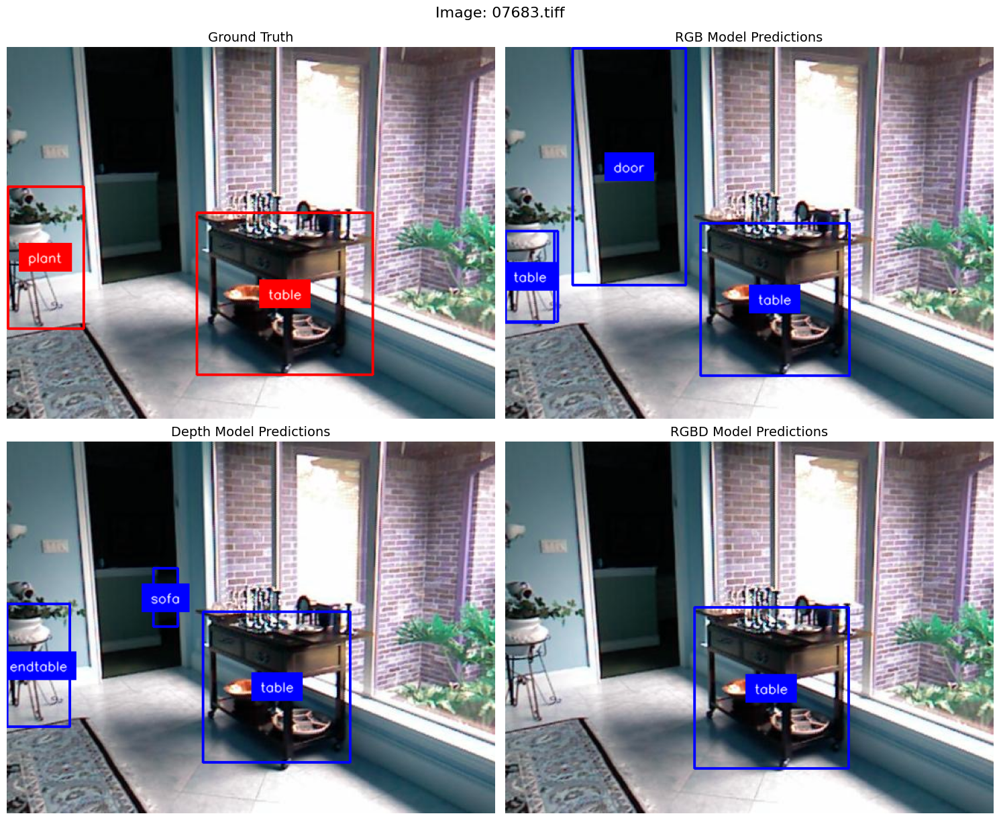

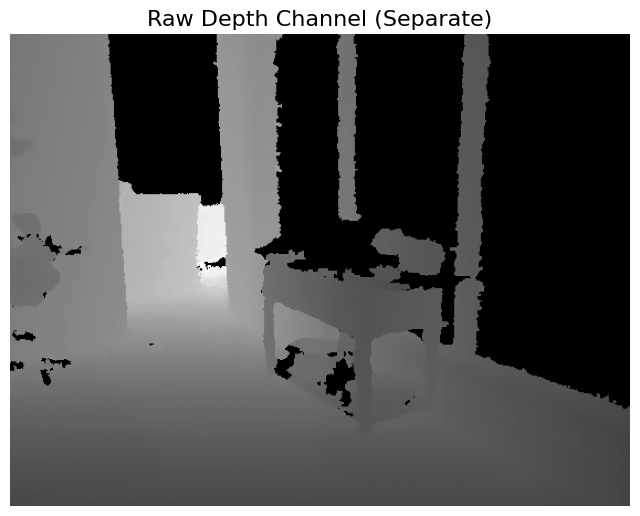


Example 2:
Image: 05060.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0, 'Depth': 0, 'RGBD': 0.6666666666666666}


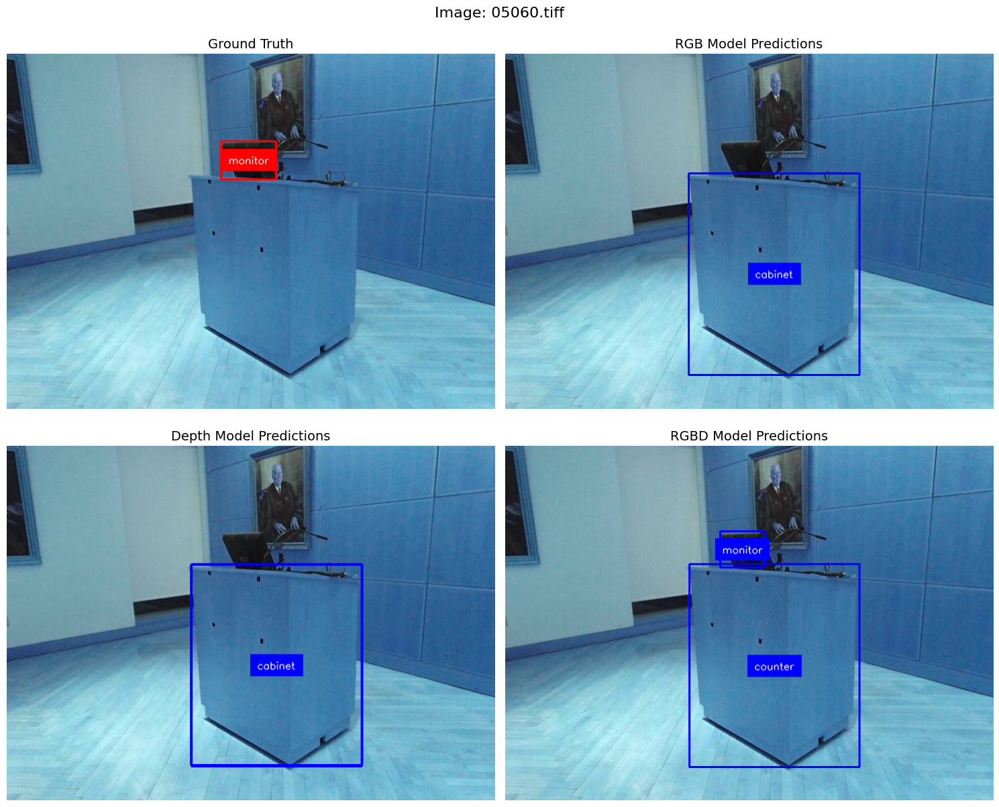

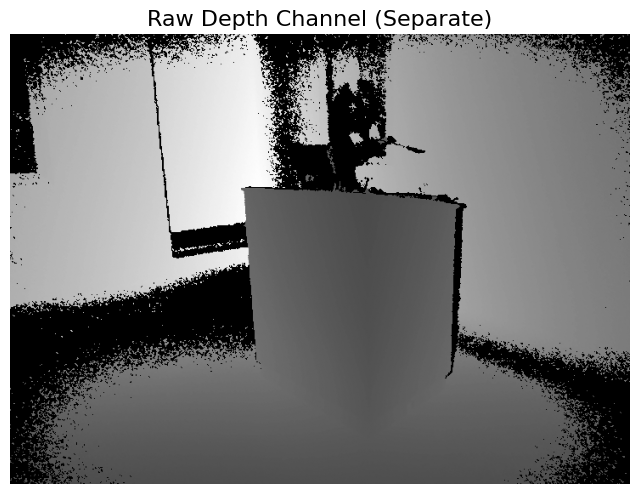


Example 3:
Image: 04247.tiff
Better model: RGB, Worse model: RGBD
F1 scores: {'RGB': 0.4, 'Depth': 0.25, 'RGBD': 0}


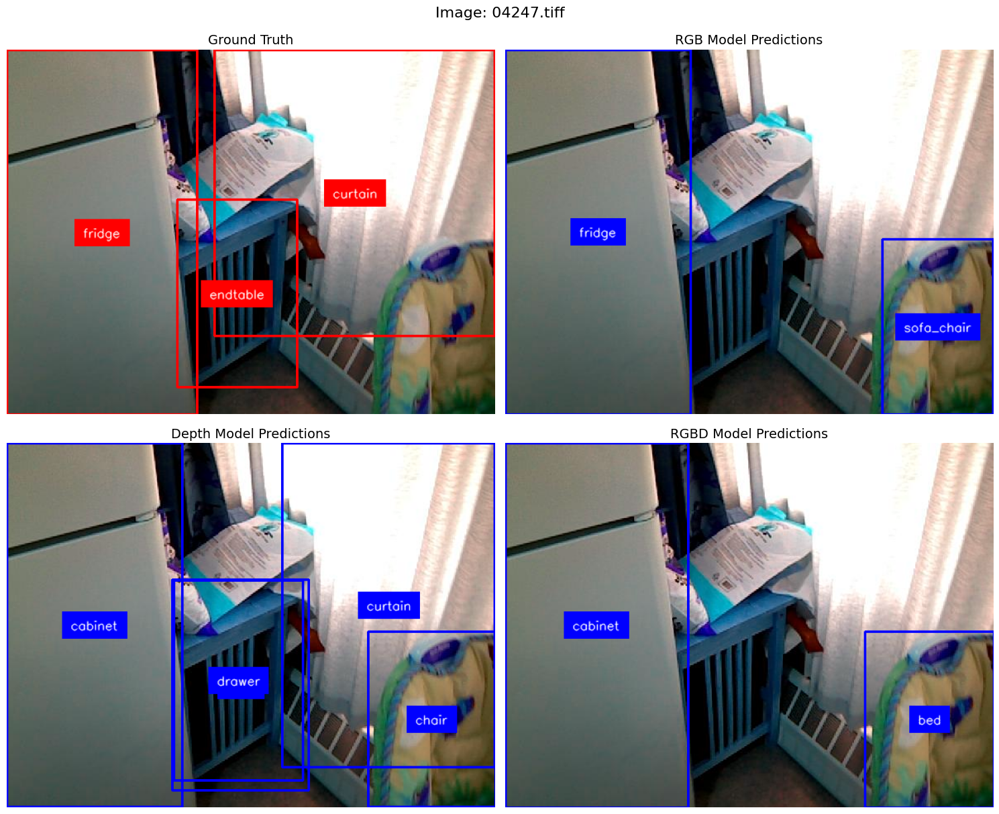

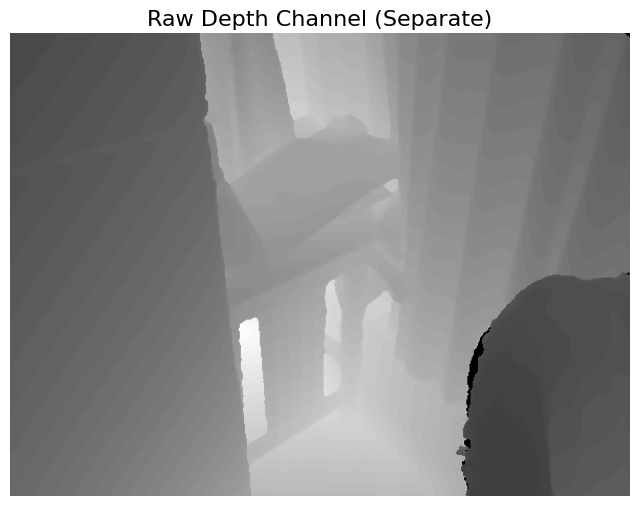


Example 4:
Image: 05753.tiff
Better model: RGB, Worse model: RGBD
F1 scores: {'RGB': 0.6666666666666666, 'Depth': 0.5, 'RGBD': 0.3333333333333333}


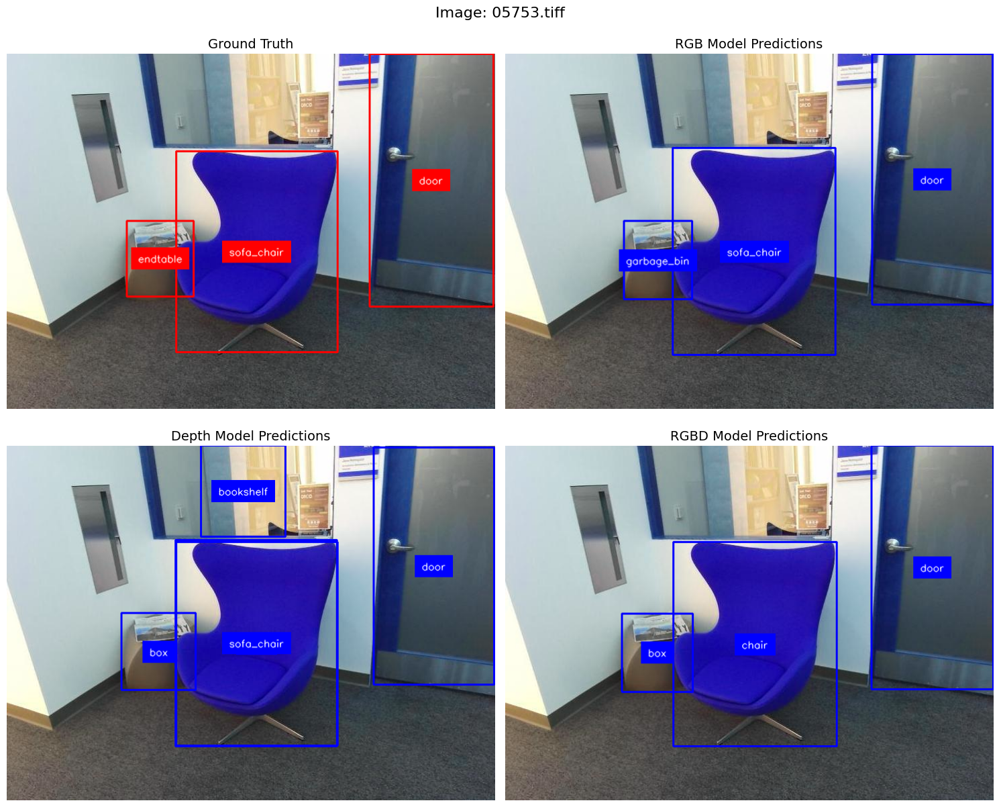

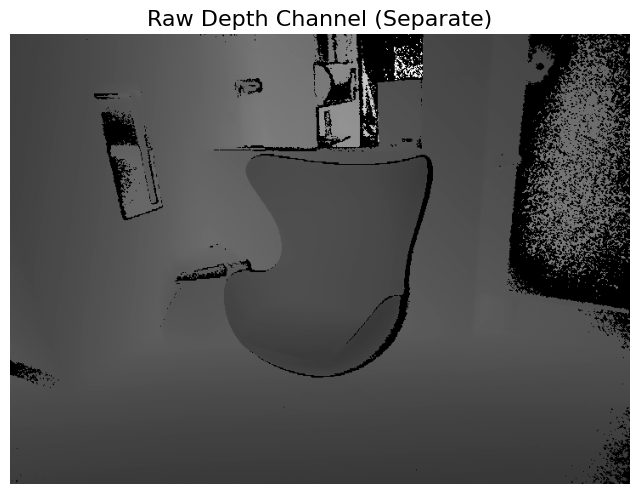


Example 5:
Image: 03778.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0, 'Depth': 0, 'RGBD': 0.6666666666666666}


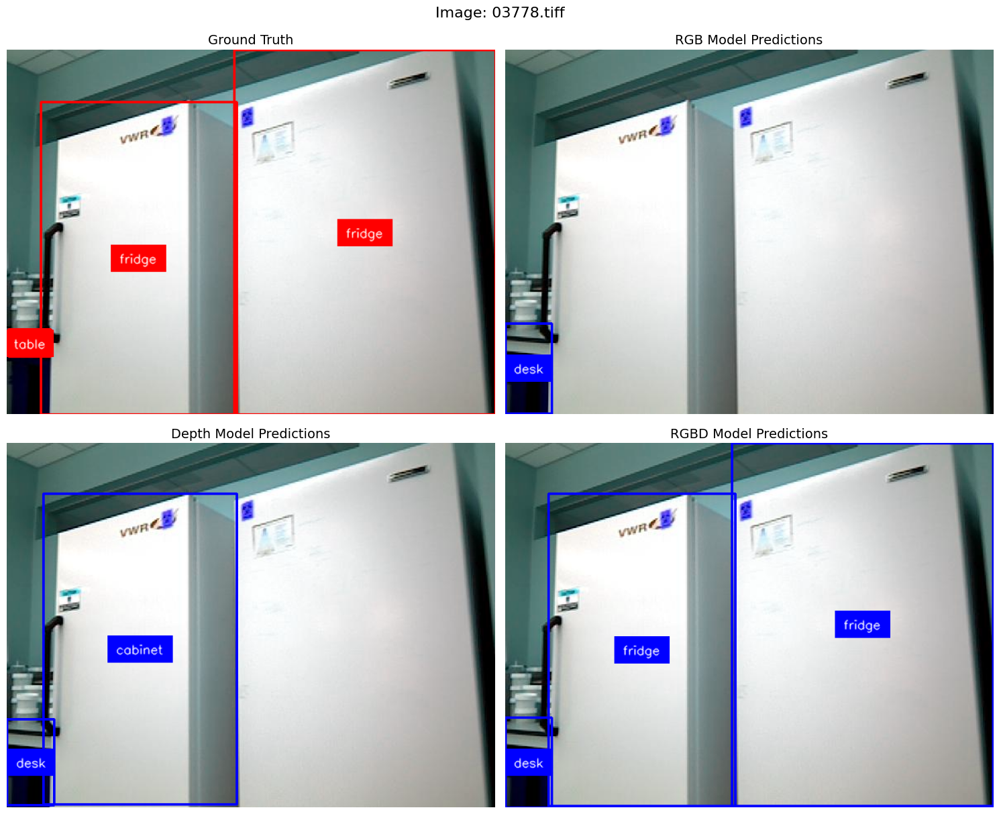

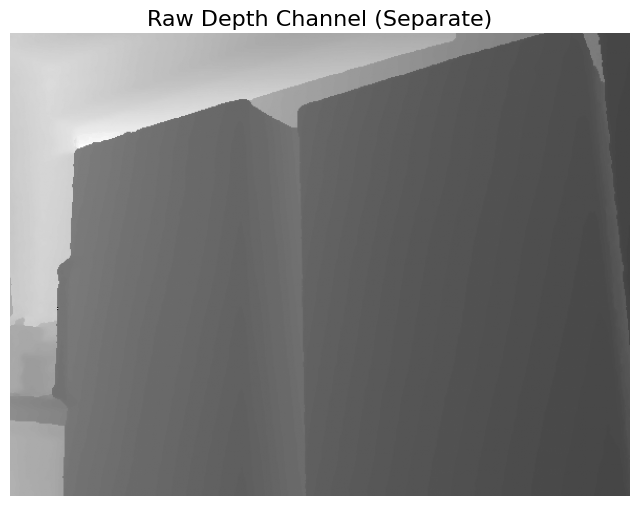


Example 6:
Image: 08722.tiff
Better model: RGB, Worse model: RGBD
F1 scores: {'RGB': 0.6666666666666666, 'Depth': 0.5, 'RGBD': 0}


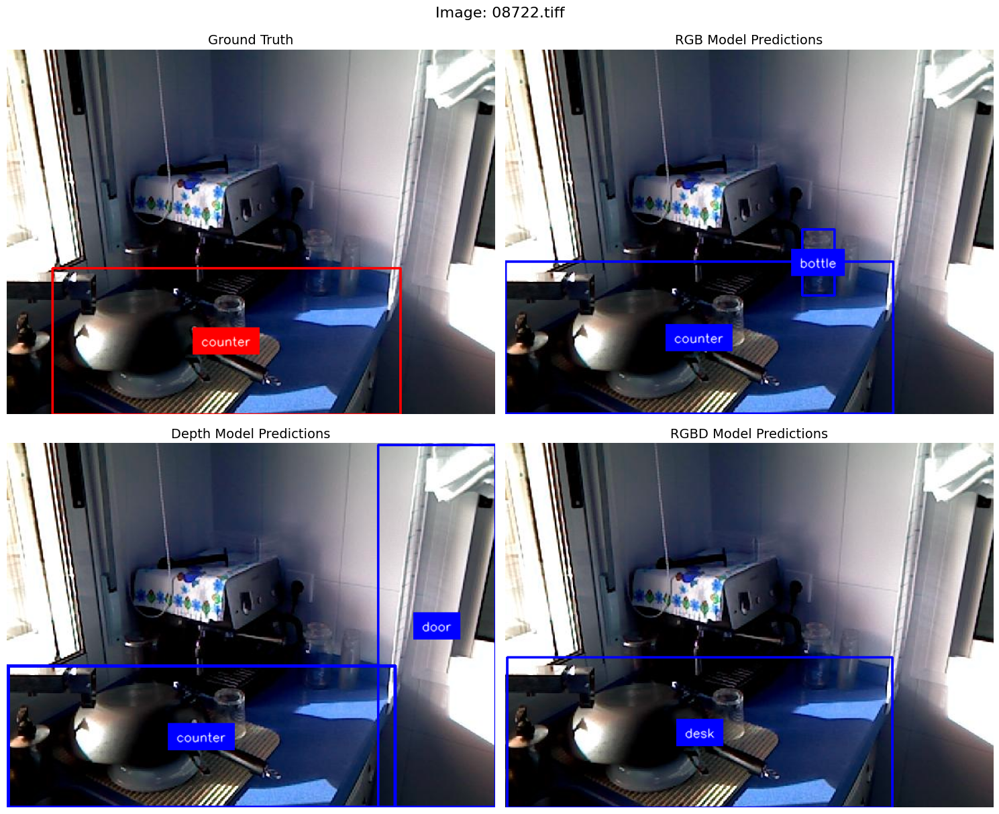

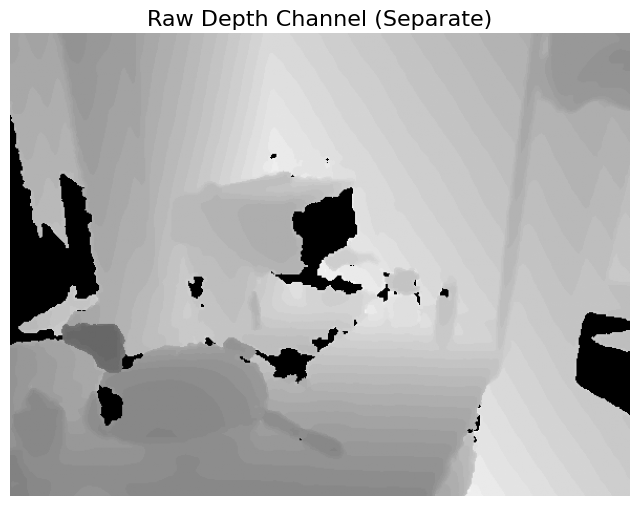


Example 7:
Image: 07116.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.23529411764705882, 'Depth': 0.2727272727272727, 'RGBD': 0.631578947368421}


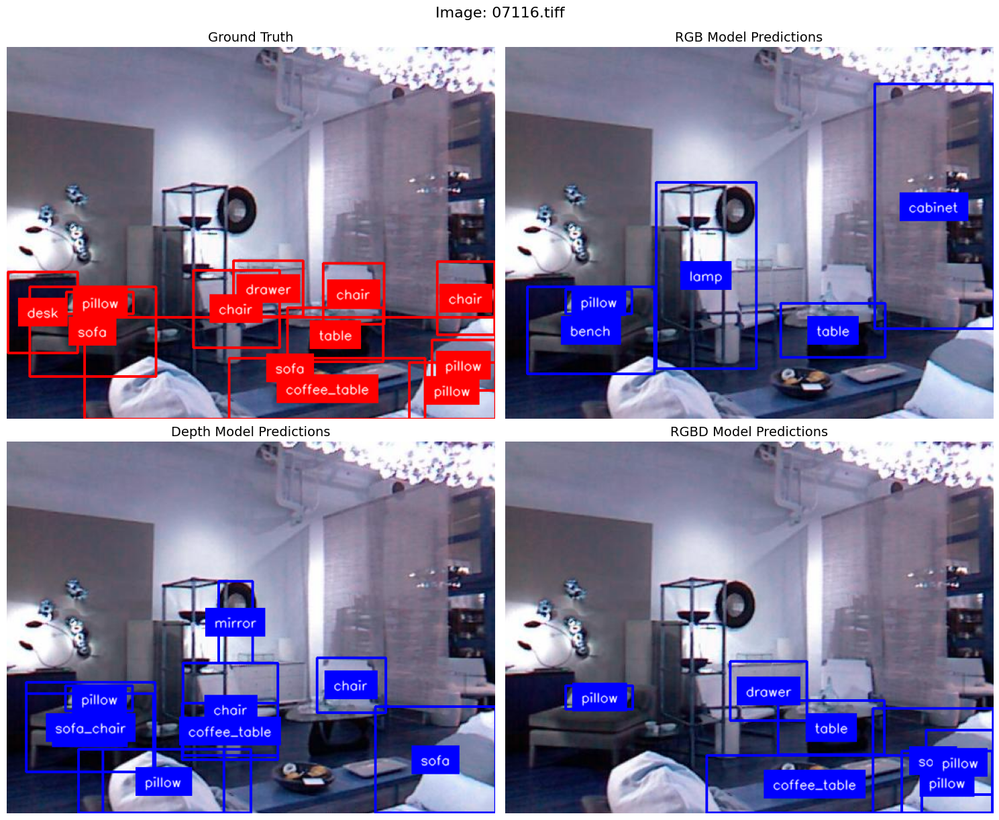

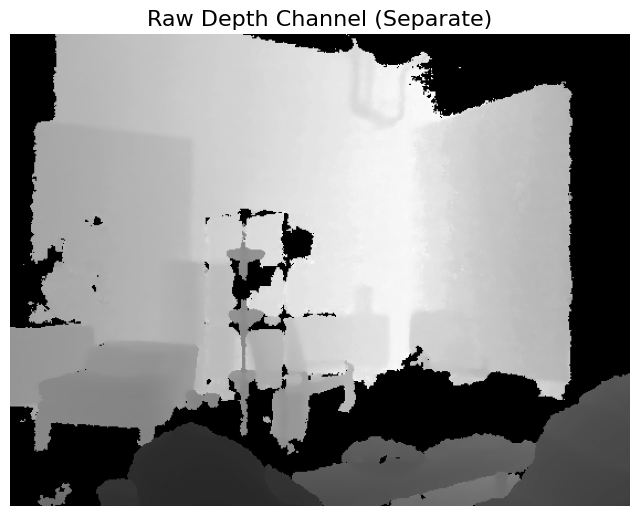


Example 8:
Image: 05869.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.6666666666666666, 'Depth': 1.0, 'RGBD': 1.0}


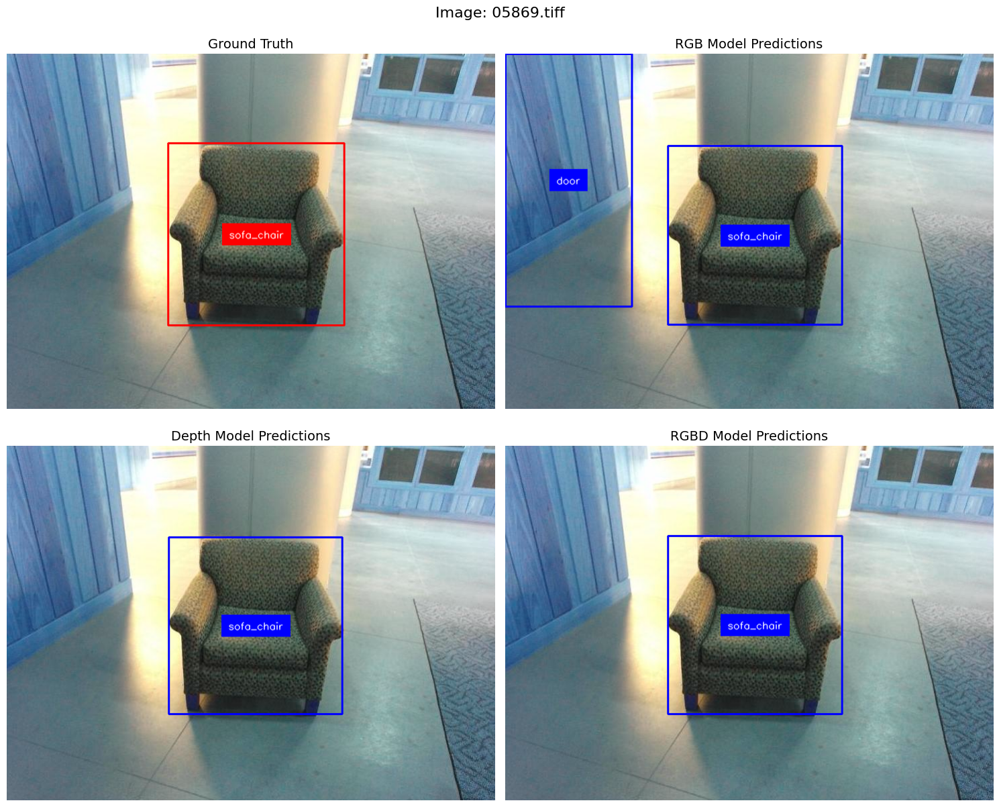

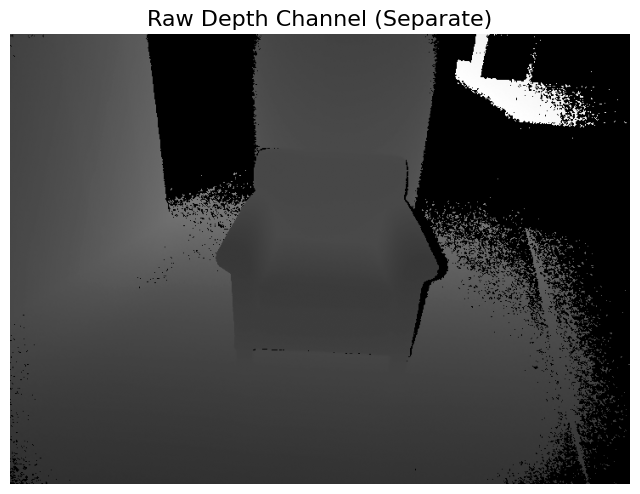


Example 9:
Image: 09281.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0, 'Depth': 0.4, 'RGBD': 0.4}


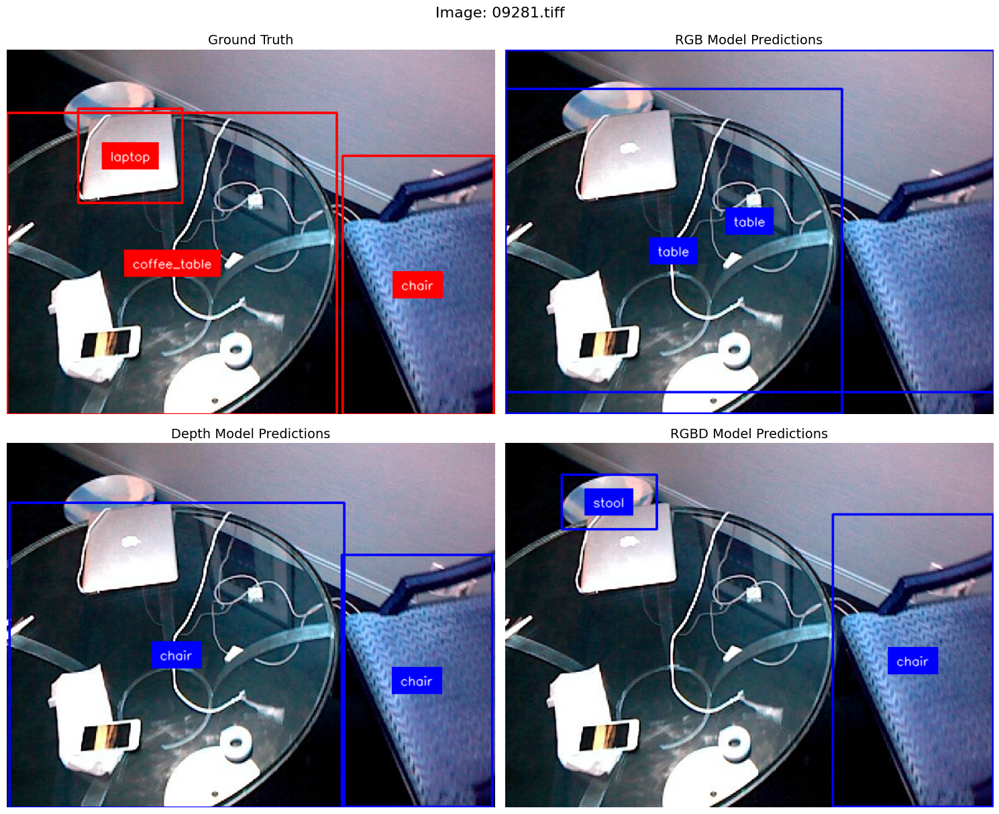

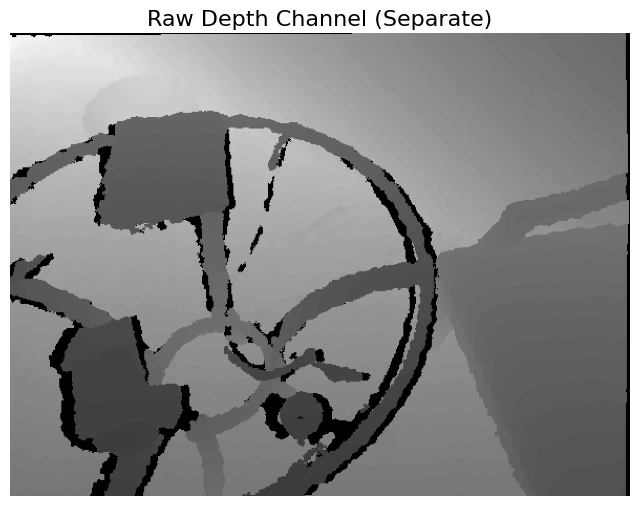


Example 10:
Image: 05660.tiff
Better model: RGB, Worse model: RGBD
F1 scores: {'RGB': 0.5, 'Depth': 0, 'RGBD': 0}


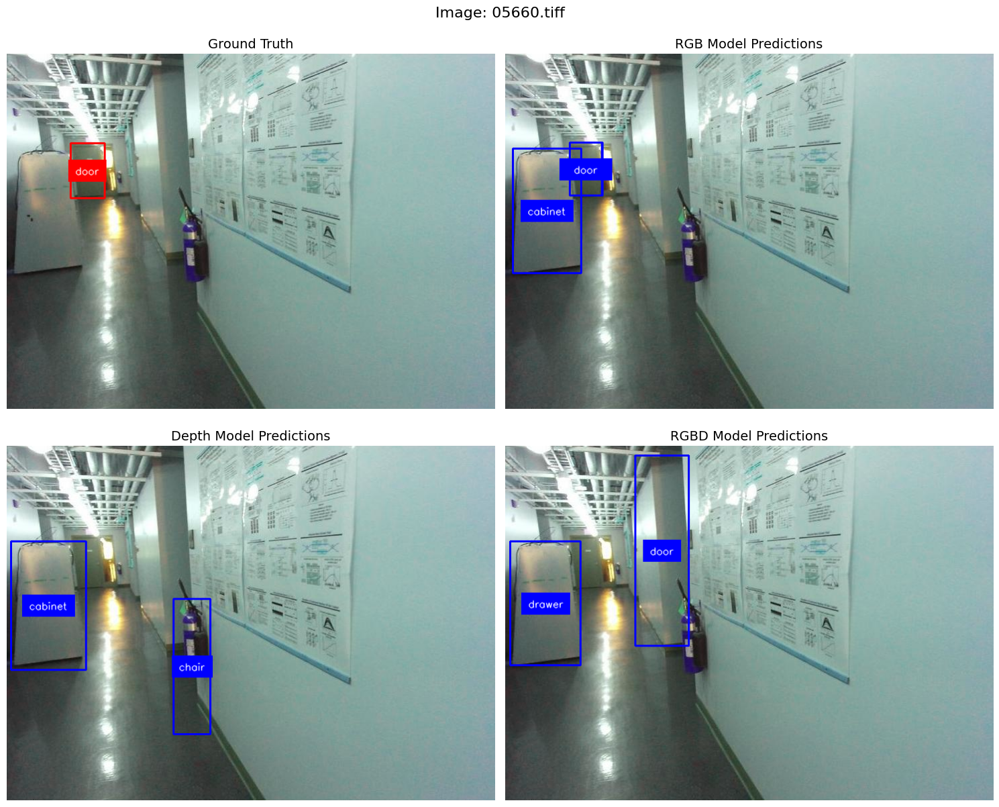

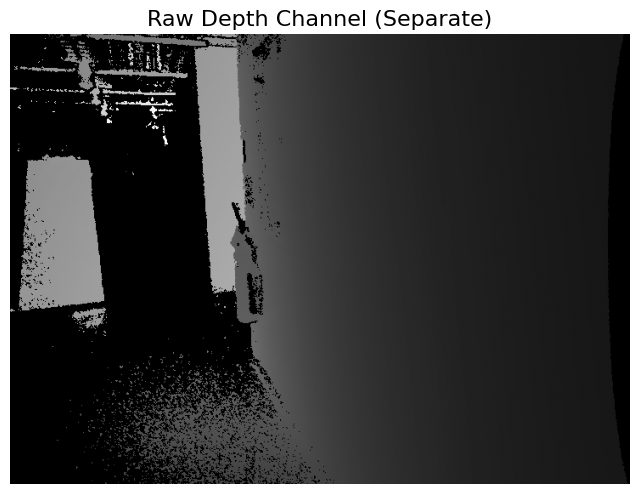


Example 11:
Image: 09046.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.5, 'Depth': 0.7499999999999999, 'RGBD': 1.0}


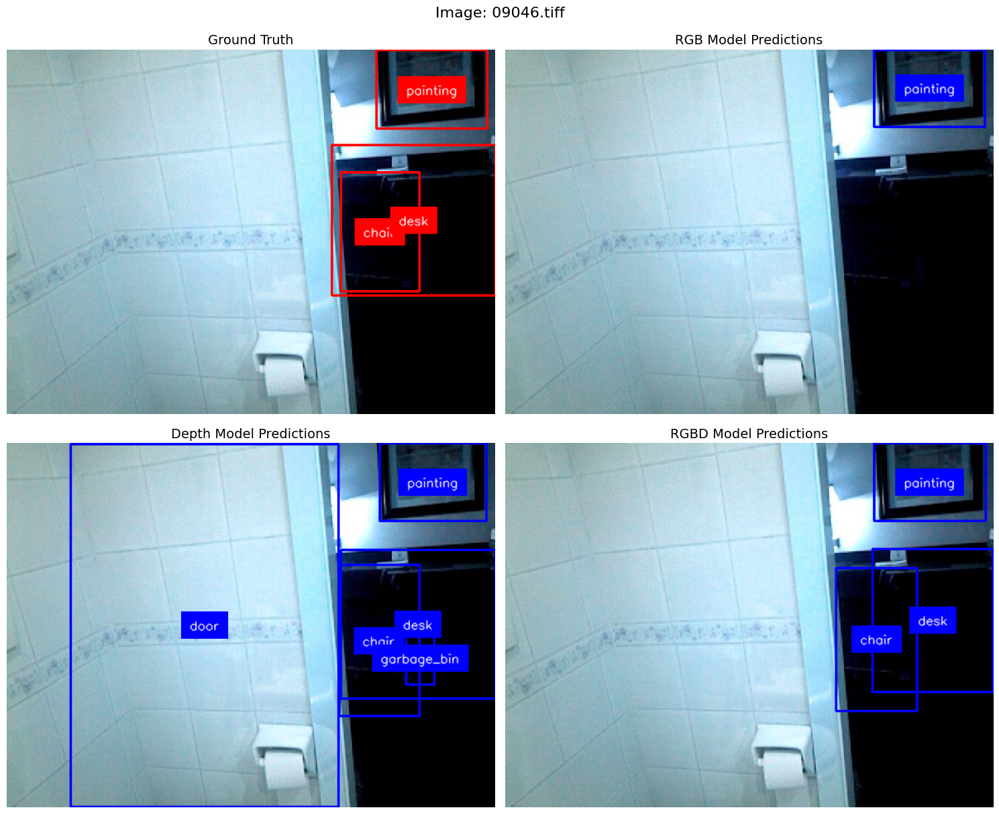

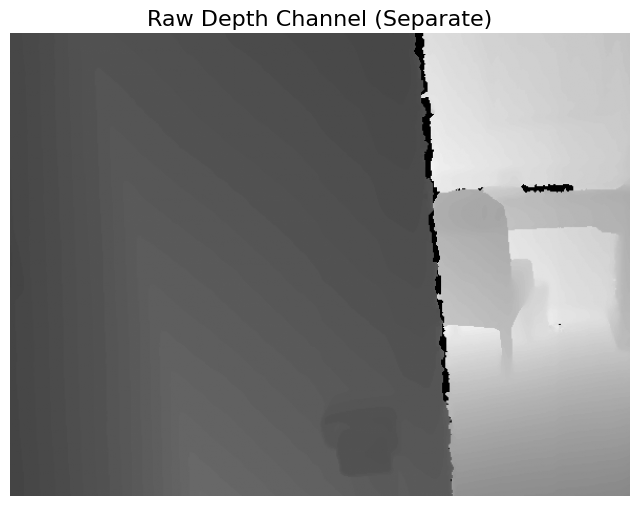


Example 12:
Image: 02727.tiff
Better model: RGB, Worse model: RGBD
F1 scores: {'RGB': 0.5, 'Depth': 0.2, 'RGBD': 0}


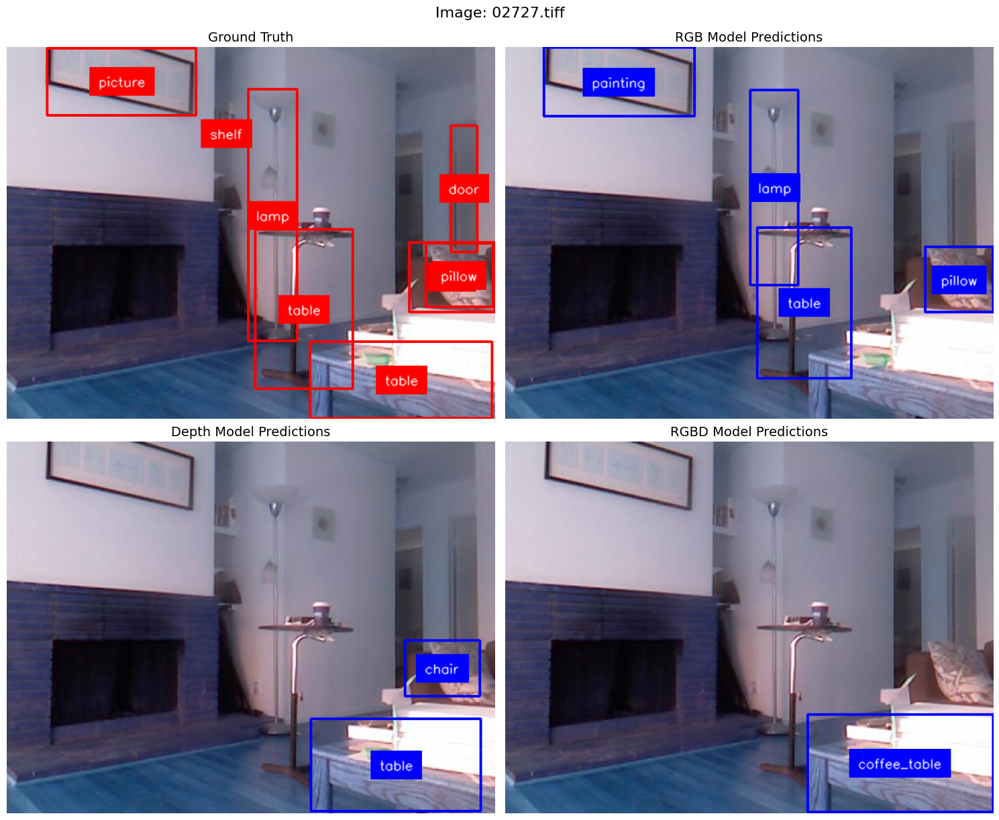

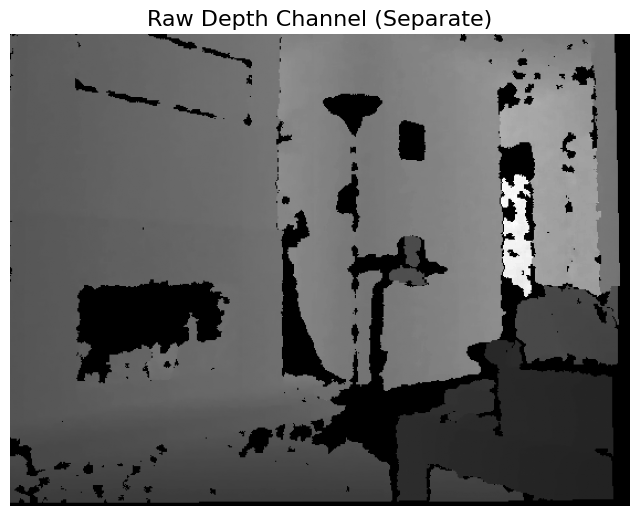


Example 13:
Image: 03977.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.4444444444444444, 'Depth': 0.7692307692307692, 'RGBD': 0.7692307692307692}


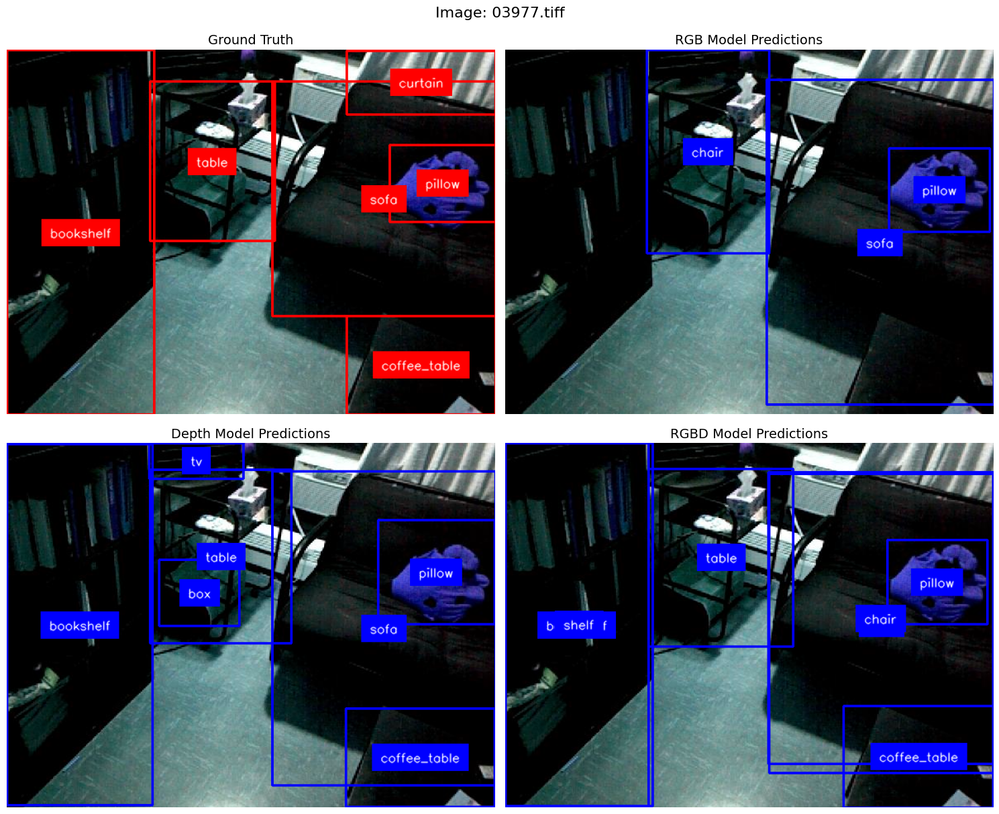

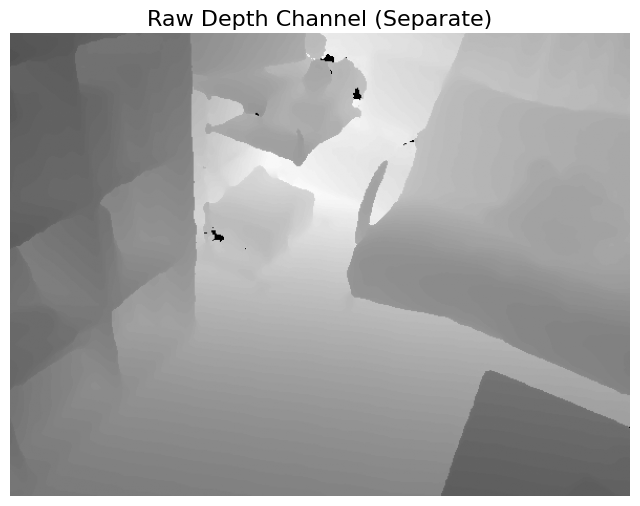


Example 14:
Image: 01939.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.2222222222222222, 'Depth': 0.8, 'RGBD': 0.5714285714285715}


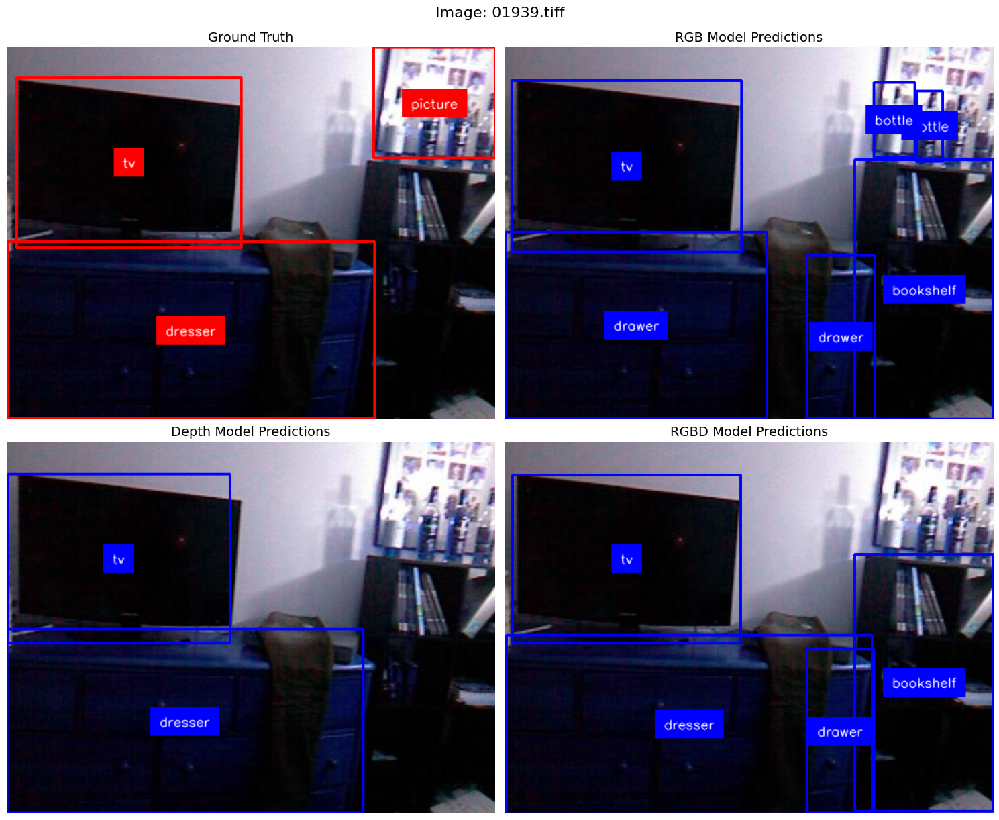

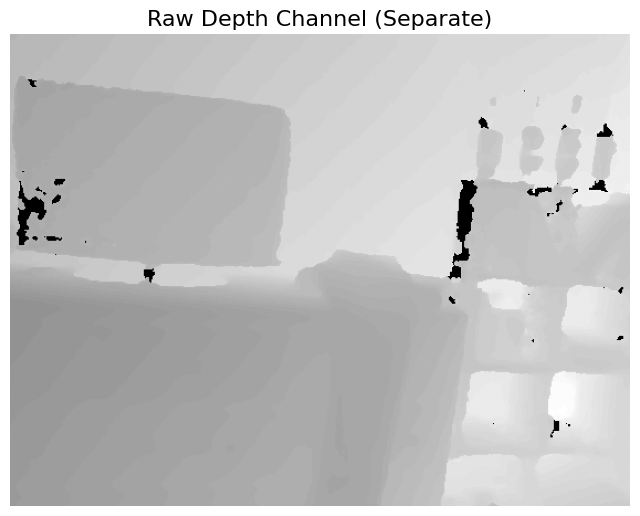


Example 15:
Image: 03846.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.3333333333333333, 'Depth': 0.5, 'RGBD': 0.8}


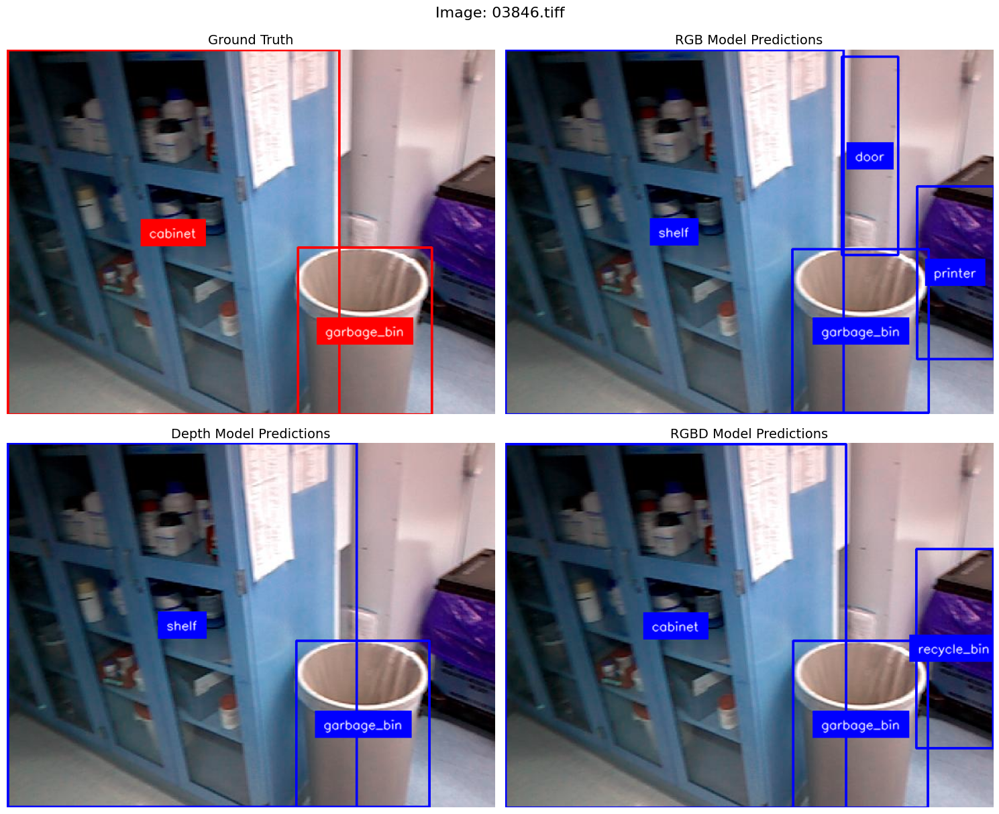

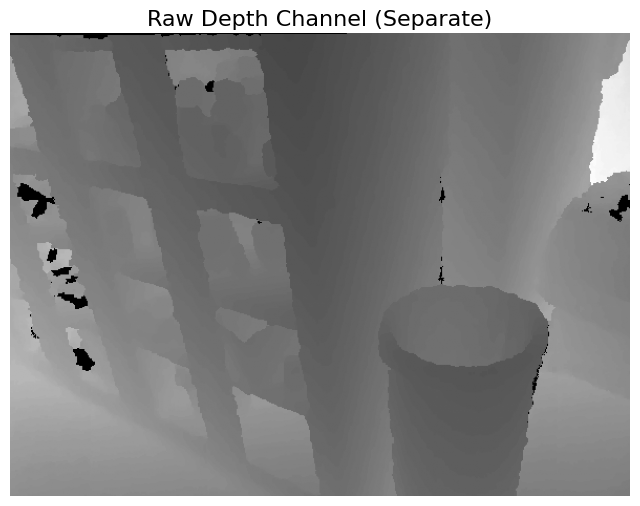


Example 16:
Image: 07199.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.14285714285714285, 'Depth': 0.5333333333333333, 'RGBD': 0.588235294117647}


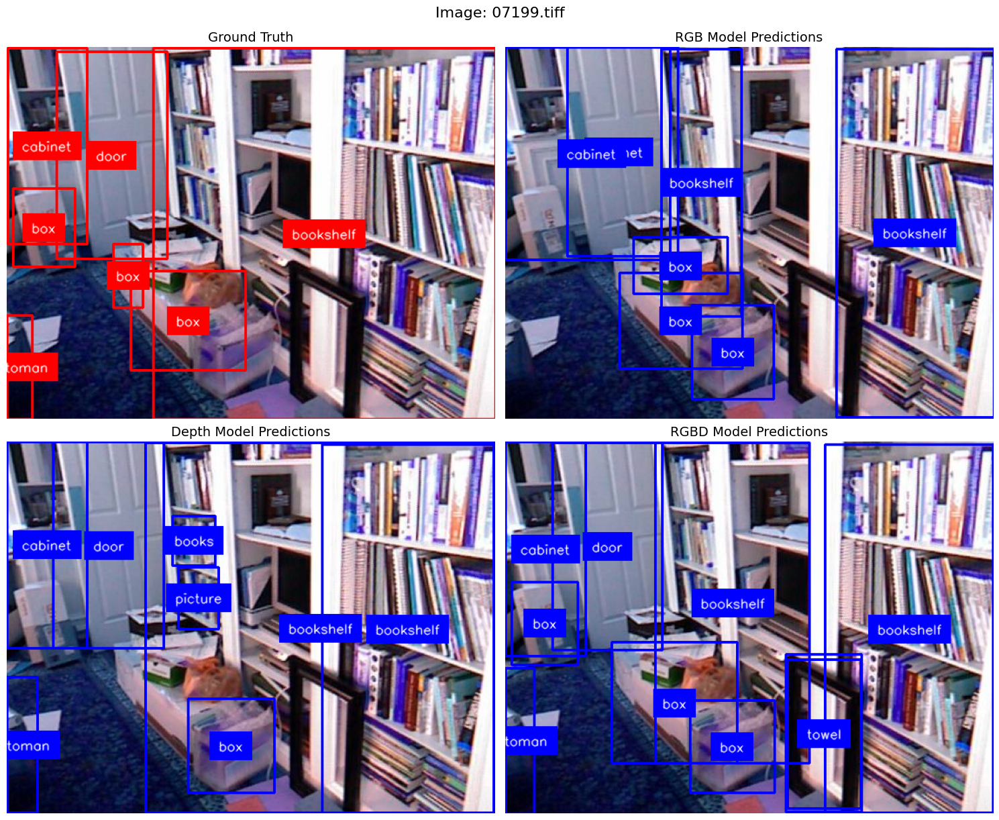

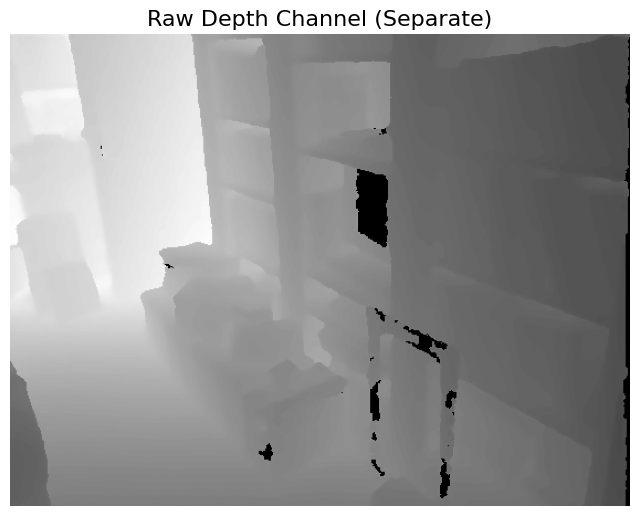


Example 17:
Image: 03002.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.6, 'Depth': 0.8333333333333333, 'RGBD': 1.0}


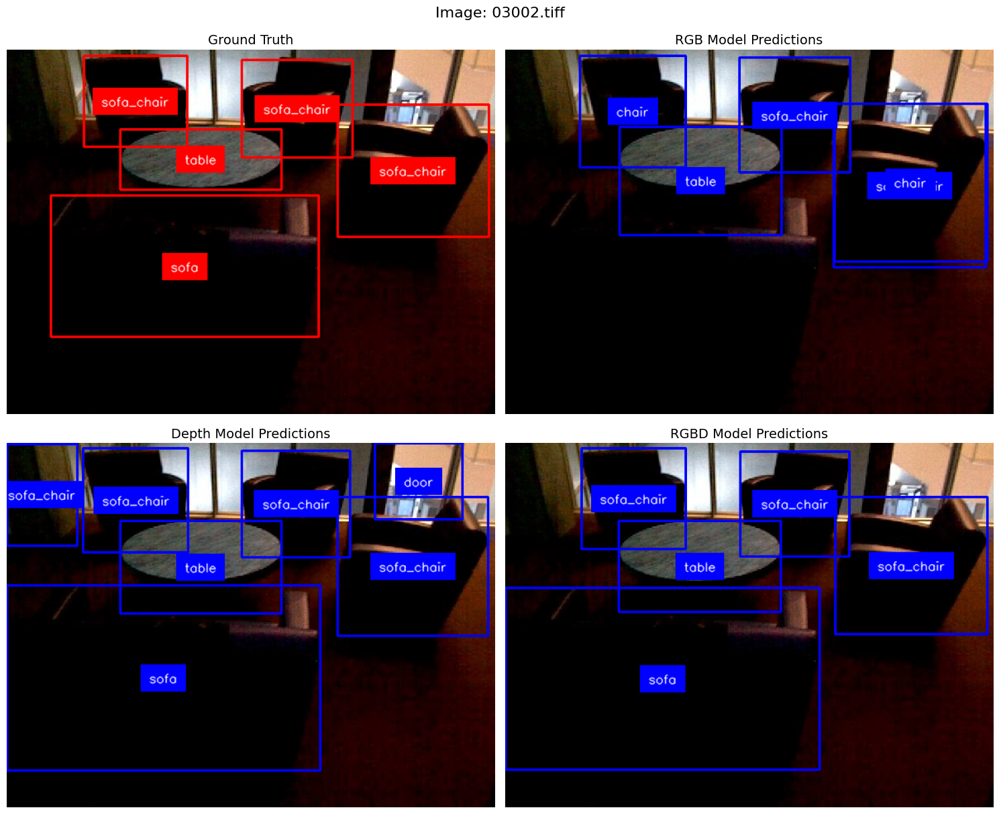

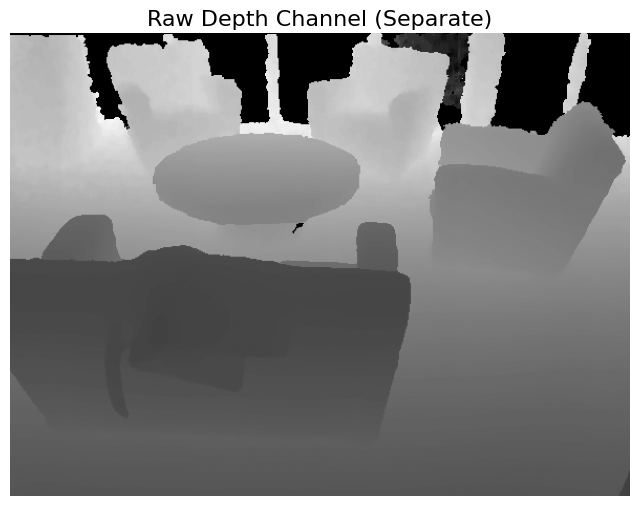


Example 18:
Image: 03099.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.4137931034482759, 'Depth': 0.45161290322580644, 'RGBD': 0.7878787878787877}


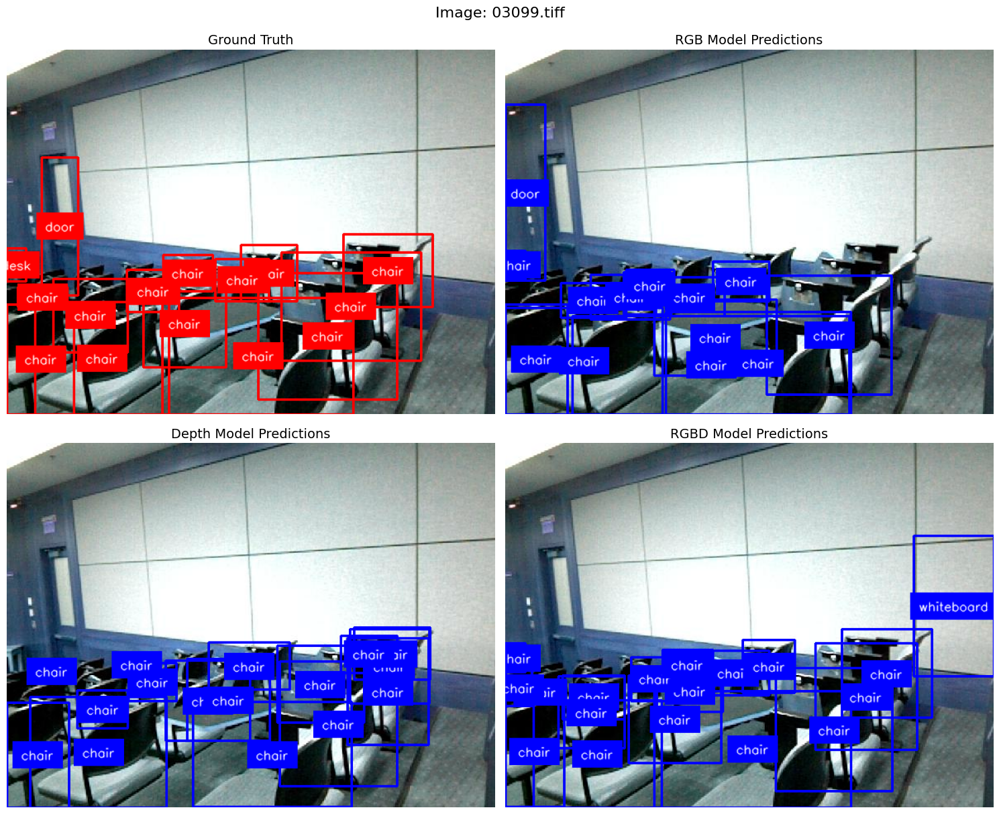

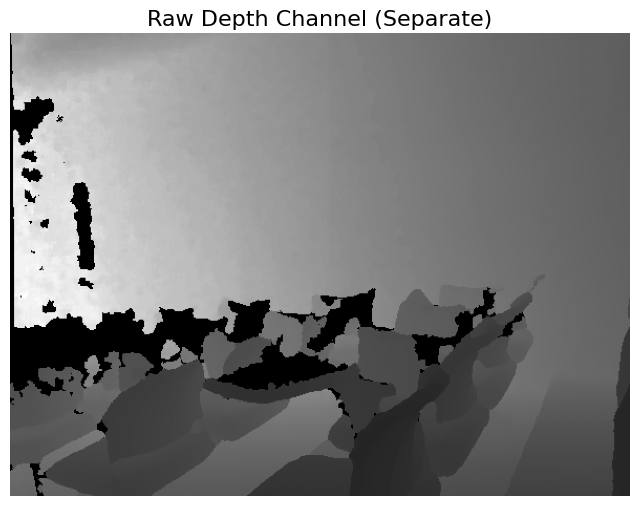


Example 19:
Image: 05094.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0, 'Depth': 0.5, 'RGBD': 0.5}


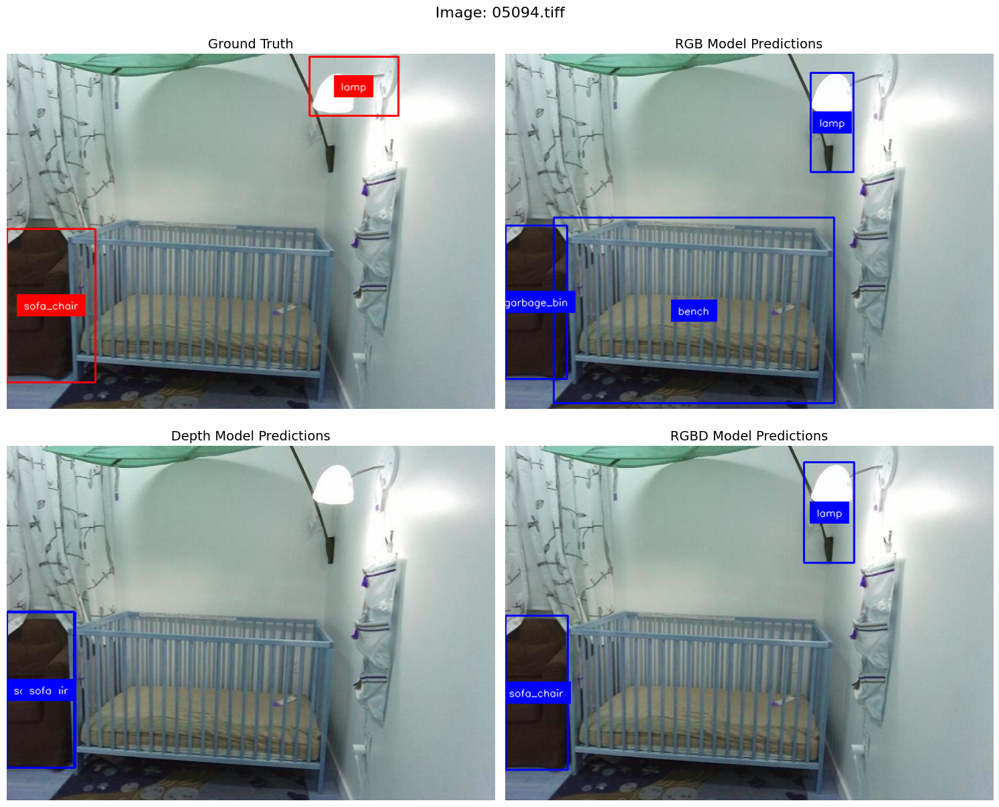

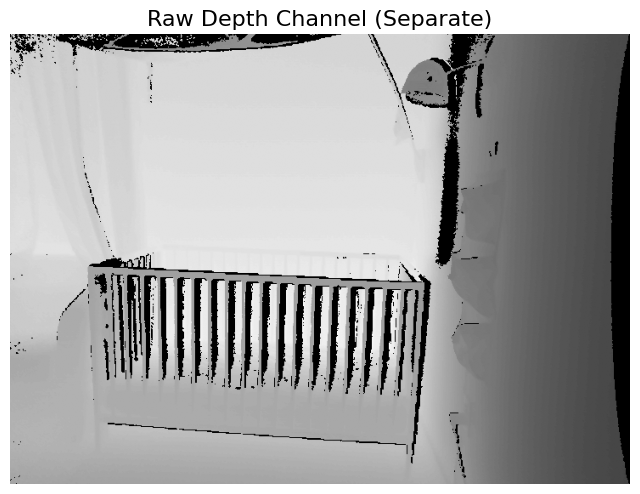


Example 20:
Image: 07484.tiff
Better model: RGBD, Worse model: RGB
F1 scores: {'RGB': 0.5454545454545454, 'Depth': 0.7272727272727272, 'RGBD': 0.888888888888889}


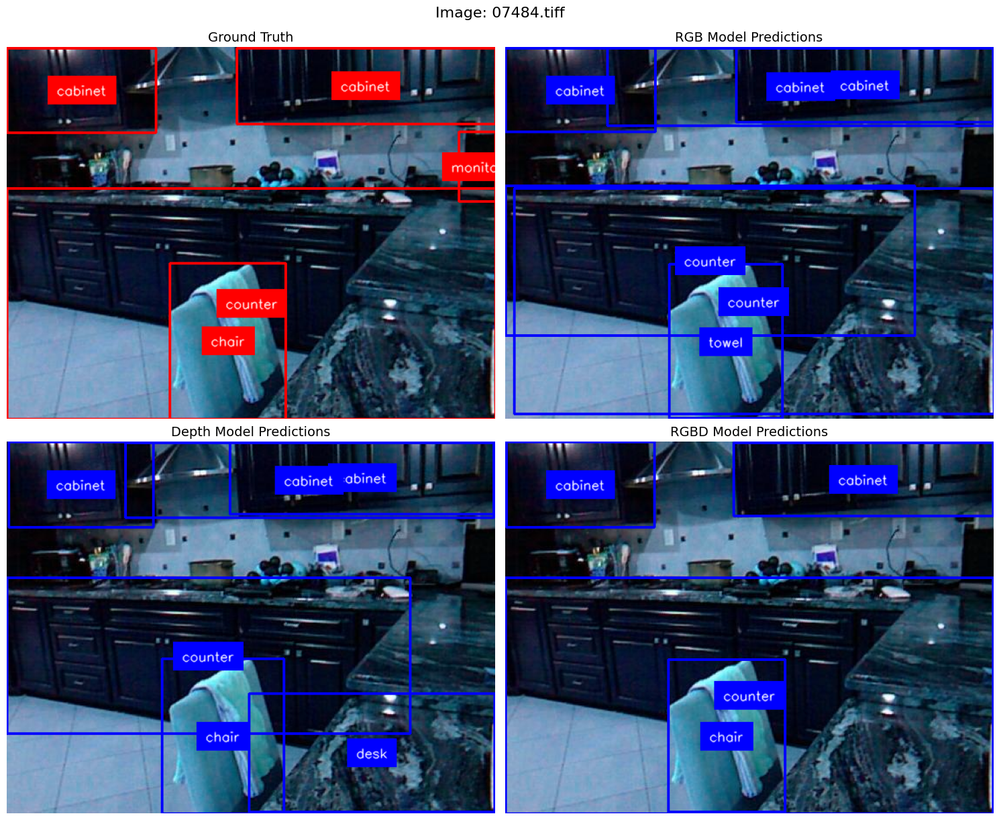

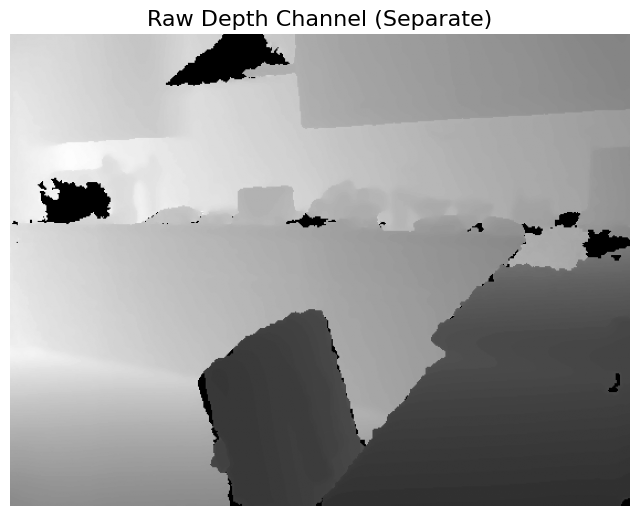

In [7]:
# Find images where models disagree significantly
interesting_examples = find_interesting_examples(results_df, model_names, difference_threshold=0.3)
print(f"Found {len(interesting_examples)} interesting examples with significant differences")

if interesting_examples:
    for i, example in enumerate(interesting_examples[:20]):
        print(f"\nExample {i+1}:")
        print(f"Image: {os.path.basename(example['image_path'])}")
        print(f"Better model: {example['better_model']}, Worse model: {example['worse_model']}")
        print(f"F1 scores: {example['f1_scores']}")
        
        visualize_model_comparison(example['image_path'], models, model_names, dataset)